# 0. Load functions and set parameters

In [1]:
# %matplotlib notebook

import os, h5py, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import torch
from torch import nn
from scipy import signal
from scipy.optimize import curve_fit
from scipy.stats import zscore

sys.path.append('../')
from visualize_functions import show_images, plot_curve, show_grid_plots, label_violinplot
from analyze_spot_functions import NormalizeData
from fitting_functions import load_curve, load_multiple_curves, detect_peaks, remove_outlier, smooth, fit_exp_function, analyze_curves
    
# from analyze_RHEED_spot_functions import show_metrics, Gaussian, generate_parameter_file, show_sound, show_fft_frequency, butter_filter, process_pass_filter
# from analyze_RHEED_intensity_functions import NormalizeData, trim_axes, show_images, show_plots
plt.rcParams.update(mpl.rcParamsDefault)

color_green = (27/255,158/255,119/255)
color_orange = (217/255,95/255,2/255)
color_purple = (117/255,112/255,179/255)

rc_plot = {'figure.figsize':(12,2.5),
          'axes.facecolor':'white',
          'axes.grid': False,
          'axes.titlesize': 18,
          'axes.labelsize': 18,

          'xtick.labelsize': 14,
          'xtick.direction': 'in',
          'xtick.top': True,
          'xtick.bottom': True,
          'xtick.labelbottom': True,
          'xtick.labeltop': False,
          
          'ytick.labelsize': 14,
          'ytick.direction': 'in',
          'ytick.right': True,
          'ytick.left': True,
          'ytick.labelleft': True,
          'ytick.labelright': False,

          'legend.fontsize': 10,
          'font.family': 'sans-serif'}

rc_img = {'figure.figsize':(8,8),
          'axes.facecolor':'white',
          'axes.grid': False,
          'axes.titlesize': 18,
          'axes.labelsize': 14,
          
          'xtick.labelsize': 12,
          'xtick.direction': 'in',
          'xtick.top': False,
          'xtick.bottom': False,
          'xtick.labelbottom': False,
          'xtick.labeltop': False,
          
          'ytick.labelsize': 12,
          'ytick.direction': 'in',
          'ytick.right': False,
          'ytick.left': False,
          'ytick.labelleft': False,
          'ytick.labelright': False,

          'legend.fontsize': 8,
          'font.family': 'sans-serif'}

In [7]:
import h5py
import numpy as np
from scipy import signal
from scipy.optimize import curve_fit
from scipy.stats import zscore
from scipy.signal import savgol_filter
from sklearn.decomposition import PCA

import sys
sys.path.append('./')
from visualize_functions import plot_curve, show_grid_plots

def load_curve(h5_para_file, growth, spot, metric, camera_freq, x_start):
    h5_para = h5py.File(h5_para_file, mode='r')
    curve_y = np.array(h5_para[growth][spot][metric])
    curve_x = np.linspace(x_start, x_start+len(curve_y)-1, len(curve_y))/camera_freq
    return curve_x, curve_y

def load_multiple_curves(h5_para_file, growth_dict, spot, metric, camera_freq=500, x_start=0, interval=200):
    x_all, y_all = [], []
    for growth_name in list(growth_dict.keys()):
        curve_x, curve_y = load_curve(h5_para_file, growth_name, spot, metric, camera_freq, x_start)
        x_start = x_start+len(curve_y)+interval
        x_all.append(curve_x)
        y_all.append(curve_y)
        
    x_all = np.concatenate(x_all)
    y_all = np.concatenate(y_all)
    return x_all, y_all


def detect_peaks(curve_x, curve_y, camera_freq, laser_freq, step_size, prominence):
    dist = int(camera_freq/laser_freq*0.6)
    step = np.hstack((np.ones(step_size), -1*np.ones(step_size)))
    dary_step = np.convolve(curve_y, step, mode='valid')
    dary_step = np.abs(dary_step)

    filtered_curve_y = dary_step/step_size
    x_peaks, properties = signal.find_peaks(dary_step, prominence=prominence, distance=dist)
    x_peaks = x_peaks[x_peaks>dist]
    x_peaks = x_peaks[x_peaks<len(curve_y)-dist]
    
    # get all partial curve 
    xs, ys = [], []
    for i in range(1, len(x_peaks)):
        xs.append(list(curve_x[5+x_peaks[i-1]:x_peaks[i]]))
        ys.append(list(curve_y[5+x_peaks[i-1]:x_peaks[i]]))
    return x_peaks/500, xs, ys

def remove_outlier(x, y, ub):
    z = zscore(y, axis=0, ddof=0)
    x = np.delete(x, np.where(z>ub))
    y = np.delete(y, np.where(z>ub))
    return x, y

def smooth(y, box_pts):
    box = np.ones(box_pts)/box_pts
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth


def normalize_0_1(y, I_start, I_end, I_diff=None, unify=True):
    if not I_diff:
        I_diff = I_end-I_start
    
    # use I/I0, I0 is saturation intensity (last value) and scale to 0-1 based 
    if I_end - I_start == 0: # avoid devide by 0
        y_nor = (y-I_start)
    elif unify:
        if I_end < I_start:
            y_nor = (I_start-y)/I_diff
        else:
            y_nor = (y-I_start)/I_diff
    else:
        if I_end < I_start:
            y_nor = (y-I_end)/I_diff
        else:
            y_nor = (y-I_start)/I_diff
    return y_nor

def de_normalize_0_1(y_nor_fit, I_start, I_end, I_diff=None, unify=True):
    
    if not I_diff:
        I_diff = I_end-I_start
    if not unify:
        I_diff = np.abs(I_diff)
    
    # use I/I0, I0 is saturation intensity (last value) and scale to 0-1 based 
    if I_end - I_start == 0: # avoid devide by 0
        y_nor = (y-I_start)
    elif unify:
        if I_end < I_start:
            y_fit = I_start-y_nor_fit*I_diff
        else:
            y_fit = y_nor_fit*I_diff+I_start

    else:
        if I_end < I_start:
            y_fit = y_nor_fit*I_diff+I_end
        else:
            y_fit = y_nor_fit*I_diff+I_start
    return y_fit
    

def process_rheed_data(xs, ys, length=500, savgol_window_order=(15, 3), pca_component=10):    
    # interpolate the data to same size 
    if length:
        xs_processed = []
        ys_processed = []
        for x, y in zip(xs, ys):
            x_sl = np.linspace(np.min(x), np.max(x), length)
            y_sl = np.interp(x_sl, x, y)
            xs_processed.append(x_sl)
            ys_processed.append(y_sl)
    xs_processed, ys_processed = np.array(xs_processed), np.array(ys_processed)

    # denoise
    if savgol_window_order:
        ys_processed = savgol_filter(ys_processed, savgol_window_order[0], savgol_window_order[1])
    if pca_component:
        pca = PCA(n_components=pca_component)
        ys_processed = pca.inverse_transform(pca.fit_transform(ys_processed))
    return xs_processed, ys_processed


def fit_exp_function(xs, ys, fit_settings = {'I_diff': 5000, 'unify': True, 'bounds':[0.01, 1], 'p_init':(1, 0.1)}):
    '''
    I_diff: Intensity difference used to normalize the curve to 0-1;
    
    '''
    def exp_func_two_functions(x, a1, b1, relax1, a2, b2, relax2):
        return (a1*x+b1)*(1 - np.exp(-x/relax1)) + (a2*x+b2)*np.exp(-x/relax2)
    

    I_diff = fit_settings['I_diff']
    bounds = fit_settings['bounds']
    p_init = fit_settings['p_init']
    unify = fit_settings['unify']

    parameters = []
    ys_nor, ys_nor_fit, ys_fit = [], [], []
    labels, losses = [], []
    
    for i in range(len(xs)):
        
        # section: normalize the curve
        x = np.linspace(1e-5, 1, len(ys[i])) # use second as x axis unit
        n_avg = len(ys[i])//100+3
        I_end = np.mean(ys[i][-n_avg:])
        I_start = np.mean(ys[i][:n_avg])
        y_nor = normalize_0_1(ys[i], I_start, I_end, I_diff, unify)
        
        
        params, params_covariance = curve_fit(exp_func_two_functions, x, y_nor, p0=p_init, bounds=bounds, absolute_sigma=False) 
        a1, b1, relax1, a2, b2, relax2 = params
        y_nor_fit = exp_func_two_functions(x, a1, b1, relax1, a2, b2, relax2)
        labels.append(f'index {i+1}:\ny1=({np.round(a1, 2)}t+{np.round(b1, 2)})*(1-exp(-t/{np.round(relax1, 2)}))\ny2=({np.round(a2, 2)}t+{np.round(b2, 2)})*exp(-t/{np.round(relax2, 2)})')
        parameters.append((a1, b1, relax1, a2, b2, relax2))
        losses.append((0, 0))


#         y_nor_fit = y1_nor_fit
        y_fit = de_normalize_0_1(y_nor_fit, I_start, I_end, I_diff, unify)
        
        ys_fit.append(y_fit)
        ys_nor.append(y_nor)
        ys_nor_fit.append(y_nor_fit)
    return np.array(parameters), [xs, ys, ys_fit, ys_nor, ys_nor_fit, labels, losses]


def analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=500, interval=1000, visualize=False, fit_settings={'savgol_window_order': (15,3), 'pca_component': 10, 'I_diff': 8000, 'unify':True, 'bounds':[0.01, 1], 'p_init':(1, 0.1)}):

    '''
    Analyzes RHEED curves for a given spot and metric.

    Args:
    - h5_para_file (str): Path of the h5 file name, containing information about the RHEED spots.
    - growth_dict (dict): Names of the growth index and corresponding frequency.
    - spot (str): Name of the RHEED spot to collect, choice of "spot_1", "spot_2" or "spot_3".
    - metric (str): Name of the metric to analyze the RHEED spot.
    - camera_freq (int): Camera frequency of data acquisition. Default camera_freq is 500 fps.
    - interval (int): Interval between two consecutive RHEED curves.
    - visualize (bool): If True, plots the analyzed data. Default is False.
    - fit_settings (dict): Setting parameters for fitting function.

    Returns:
    - parameters_all (ndarray): Fitted parameters for all RHEED curves.
    - x_list_all (ndarray): Laser ablation counts for all RHEED curves.
    - info_all (list): List containing all processed RHEED data.
    '''

    parameters_all, x_list_all = [], []
    xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all = [], [], [], [], [], [], []
    
    x_end = 0
    for growth_name in list(growth_dict.keys()):

        # load data
        sample_x, sample_y = load_curve(h5_para_file, growth_name, 'spot_2', 'img_intensity', camera_freq=500, x_start=0)

        # detect peaks
        x_peaks, xs, ys = detect_peaks(sample_x, sample_y, camera_freq=camera_freq, laser_freq=growth_dict[growth_name],
                                       step_size=5, prominence=0.1)
        
        xs, ys = process_rheed_data(xs, ys, length=500, savgol_window_order=fit_settings['savgol_window_order'], pca_component=fit_settings['pca_component'])        

        
        # fit exponential function
        parameters, info = fit_exp_function(xs, ys, fit_settings=fit_settings)        
        parameters_all.append(parameters)
        xs, ys, ys_fit, ys_nor, ys_nor_fit, labels, losses = info
        xs_all.append(xs)
        ys_all.append(ys)
        ys_fit_all+=ys_fit
        ys_nor_all+=ys_nor
        ys_nor_fit_all+=ys_nor_fit
        labels_all += labels
        losses_all += losses

        x_list = x_peaks[:-1] + x_end
        x_end = round(x_end + (len(sample_x)+interval)/camera_freq, 2)
        x_list_all.append(x_list)
        
        if visualize:
            print(growth_name, ':')

            labels_dict = {}
            for i, x in enumerate(x_peaks[:-1]):
                labels_dict[x] = labels[i]
            plot_curve(np.concatenate(xs), np.concatenate(ys), curve_y_fit=np.concatenate(ys_fit), labels_dict=labels_dict,
                       plot_type='scatter', xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12, 4))  

#             plot_curve(x_peaks[:-1], parameters[:,0], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Constant (a.u.)', yaxis_style='linear', figsize=(12, 4))
#             plot_curve(x_peaks[:-1], parameters[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', yaxis_style='linear', figsize=(12, 4))
#             plot_curve(x_peaks[:-1], parameters[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', yaxis_style='linear', figsize=(12, 4))
            
            print('Fitting curves for normalized data:')
            show_grid_plots(xs, ys_nor, labels, ys_nor_fit, ylim=None)
            print('Fitting curves for raw data:')
            show_grid_plots(xs, ys, labels, ys_fit, ylim=None)
        

    parameters_all = np.concatenate(parameters_all, 0)
    x_list_all = np.concatenate(x_list_all)[:len(parameters_all)]
    xs_all = np.concatenate(xs_all)
    ys_all = np.concatenate(ys_all)
    return parameters_all, x_list_all, [xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, np.array(losses_all)]

## 4.1 Fitting RHEED Intensity with Exponential Function for Intensity Magnitude and Characteristic Time

In [8]:
spot = 'spot_2'
metric = 'img_intensity'
interval = 1000
camera_freq = 500
fit_settings = {'savgol_window_order': (15, 3), 'pca_component': 10, 'I_diff': 15000, 
                'unify':False, 'bounds':[0.001, 1], 'p_init':[0.1, 0.4, 0.1, 0.1, 0.4, 0.1]}

### 4.1.1 Treated substrate (step width=0.43±0.04μm) - growth_1 - fitting with sklearn functions

growth_1. :


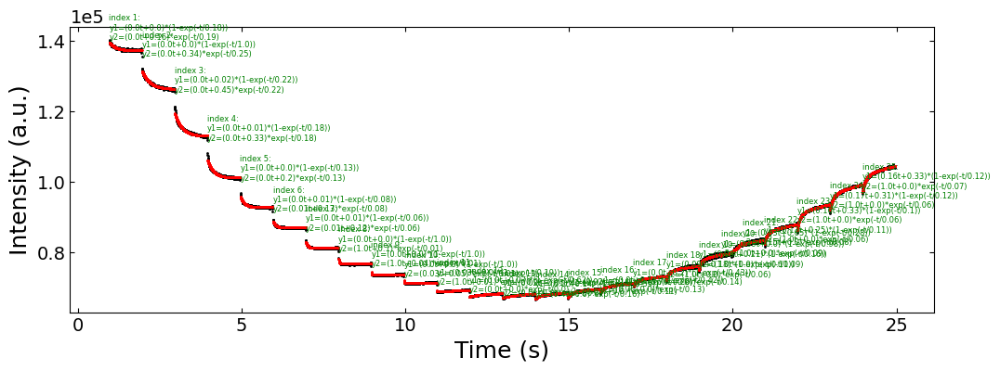

Fitting curves for normalized data:


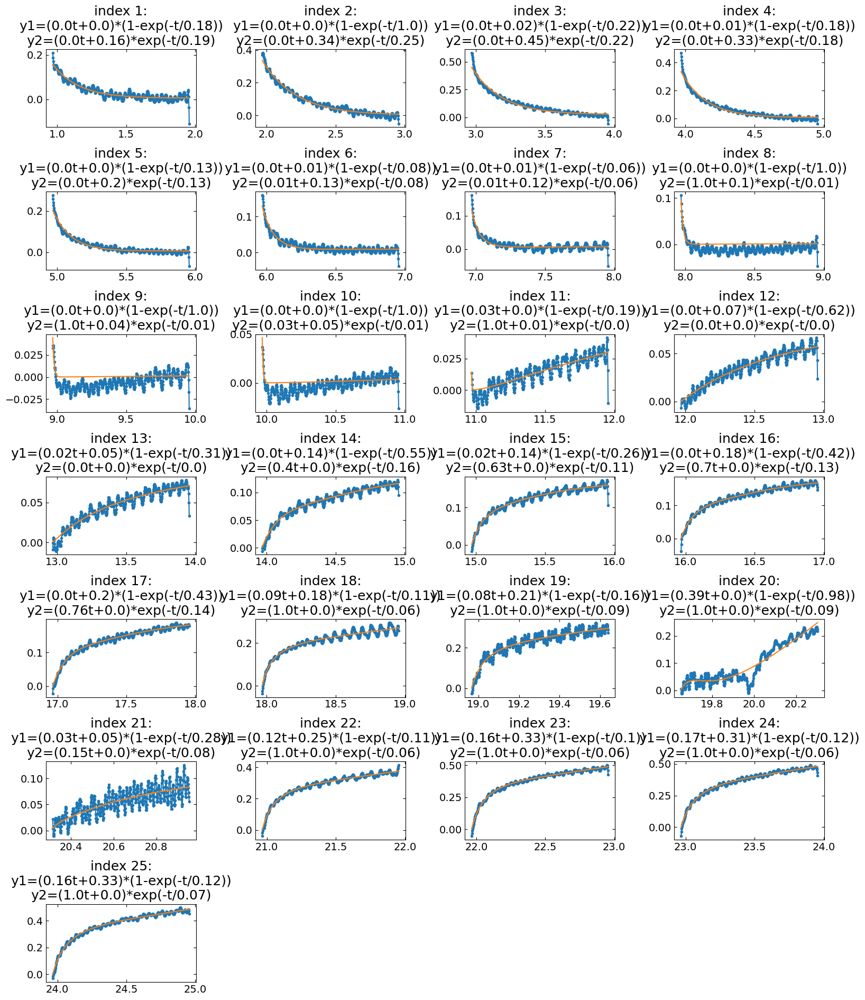

Fitting curves for raw data:


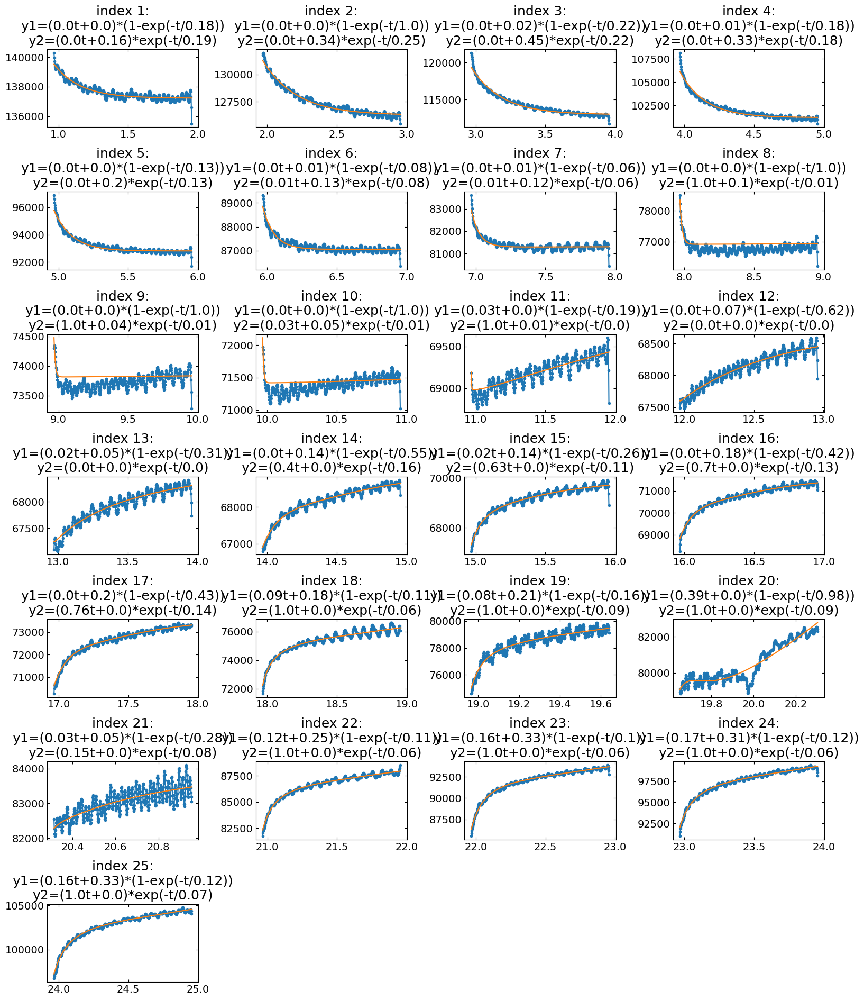

growth_2 :


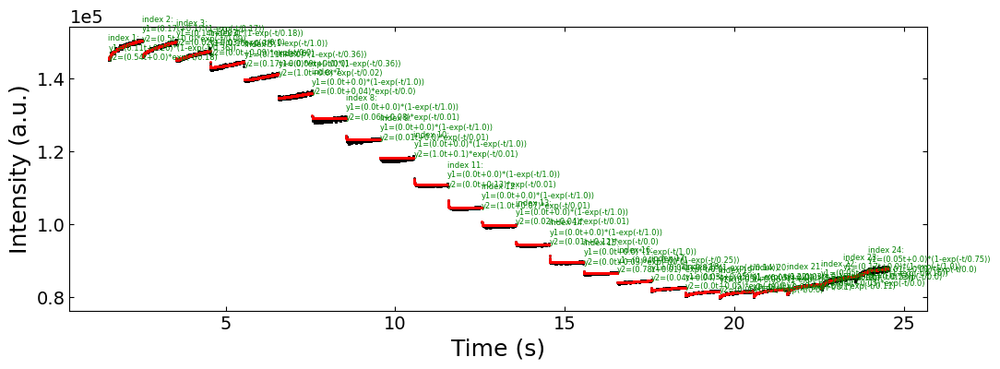

Fitting curves for normalized data:


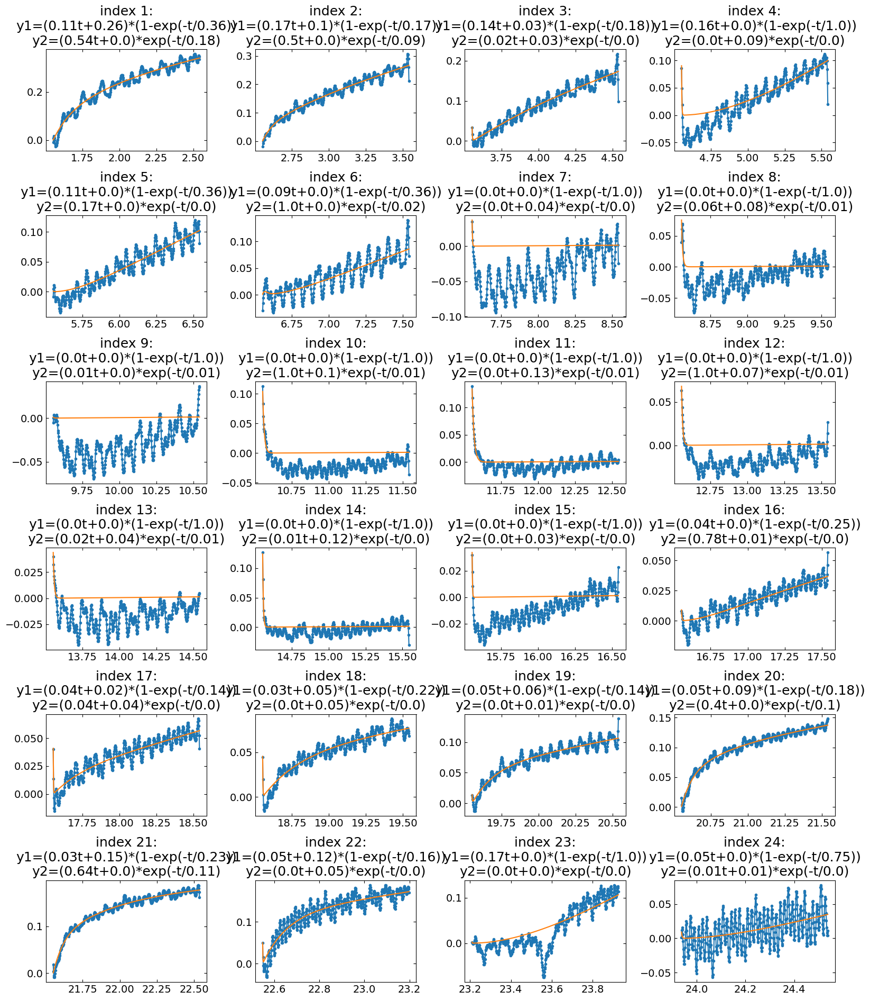

Fitting curves for raw data:


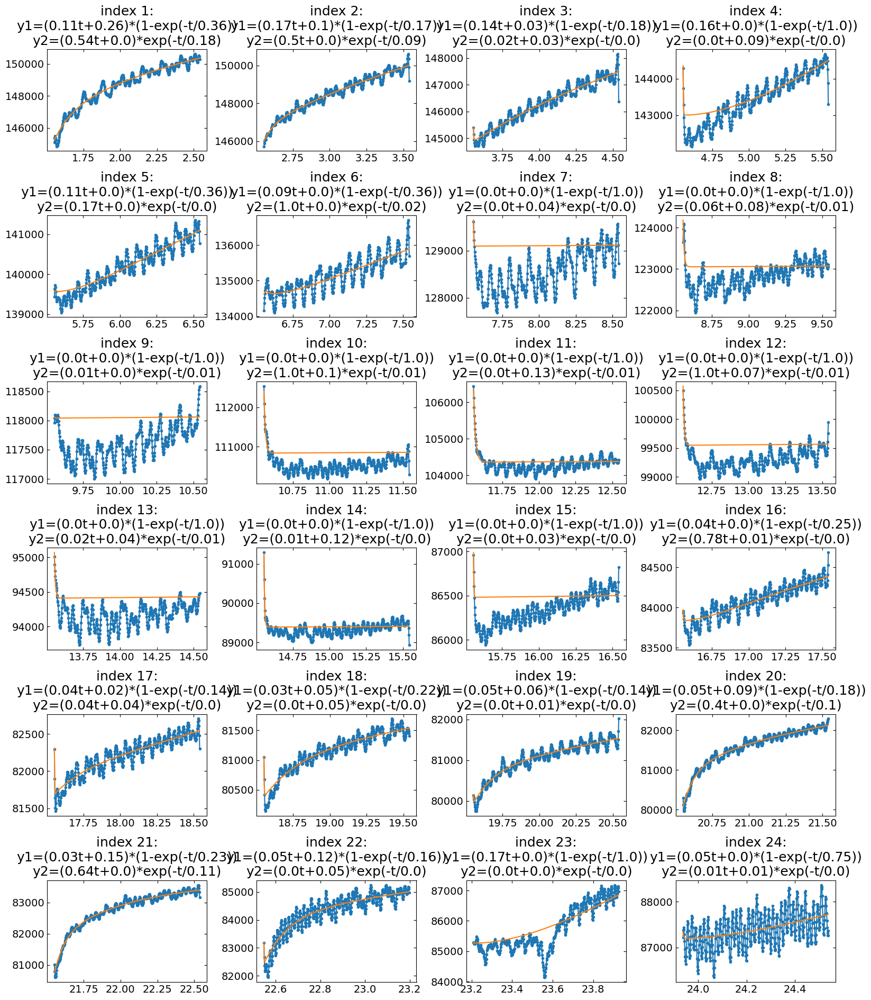

growth_3 :


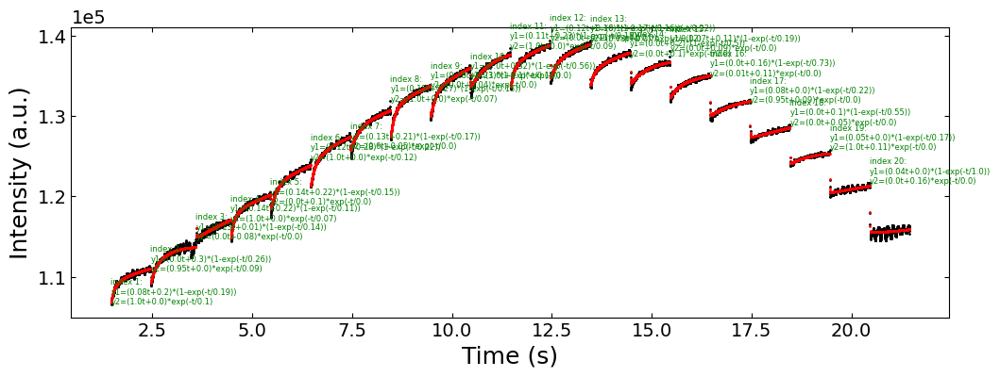

Fitting curves for normalized data:


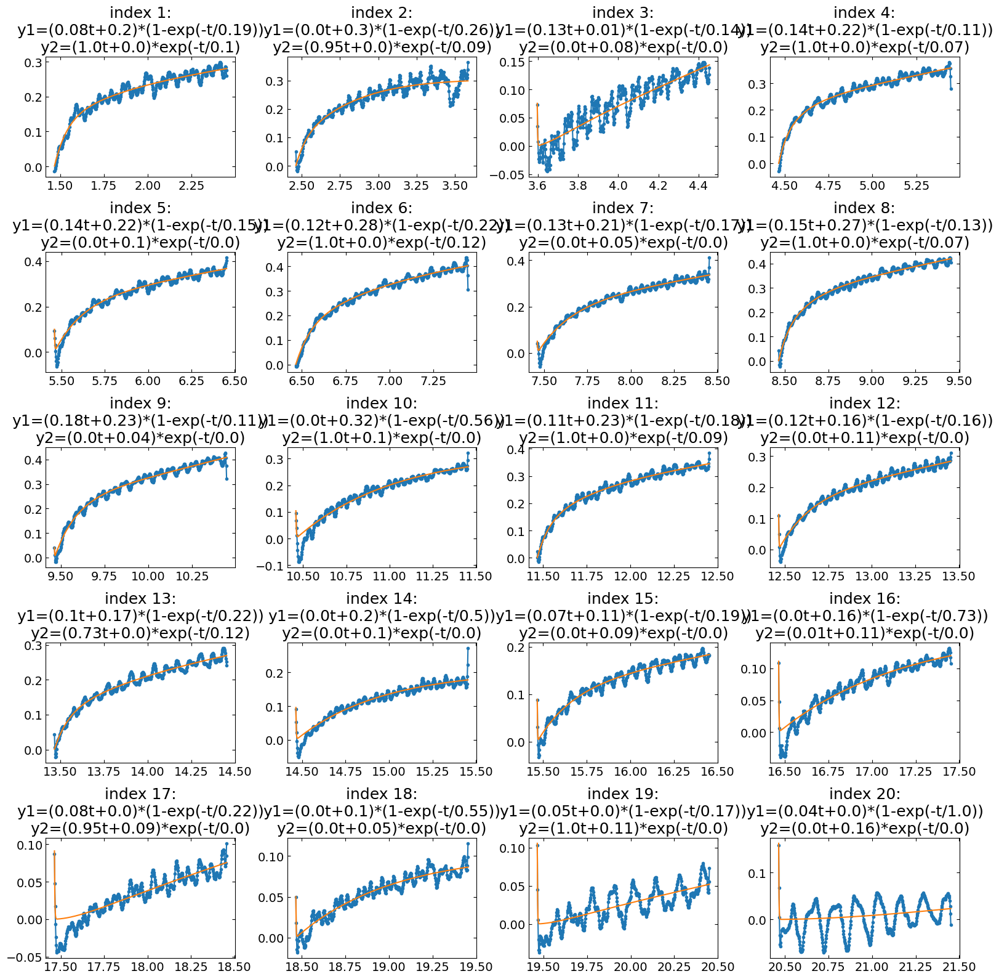

Fitting curves for raw data:


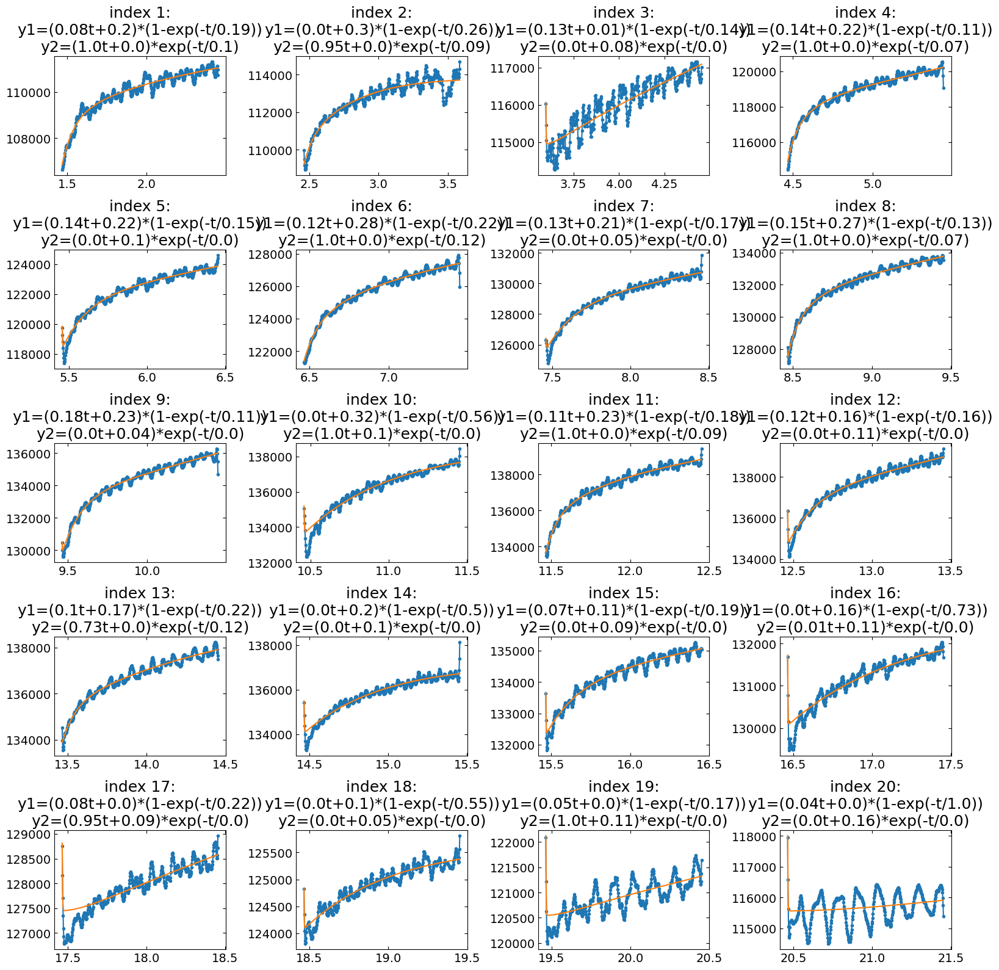

growth_4 :


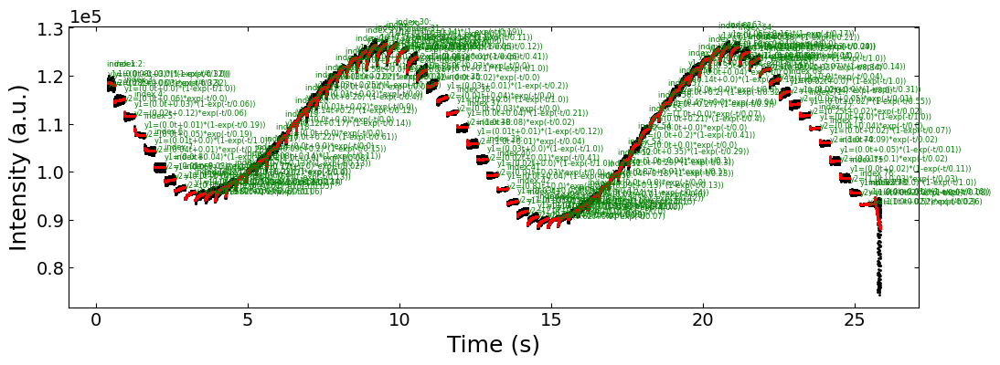

Fitting curves for normalized data:


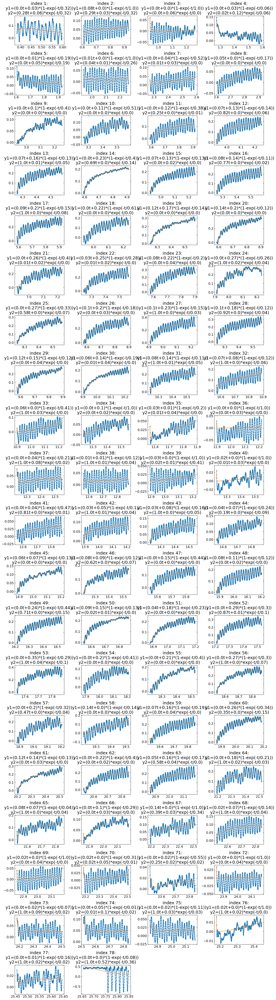

Fitting curves for raw data:


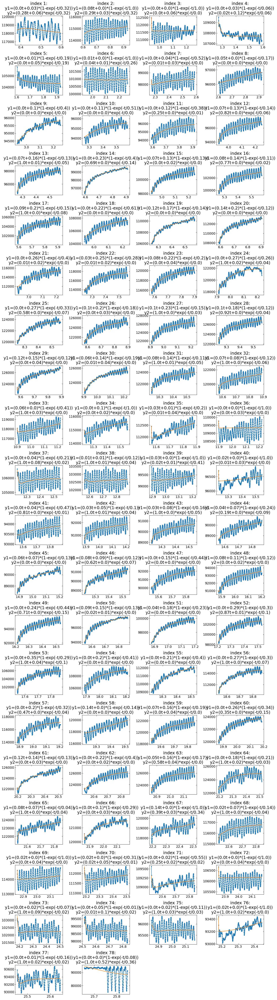

growth_5 :


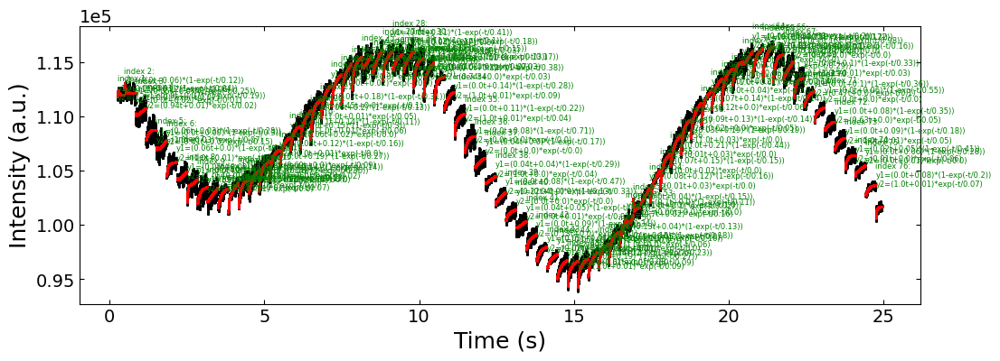

Fitting curves for normalized data:


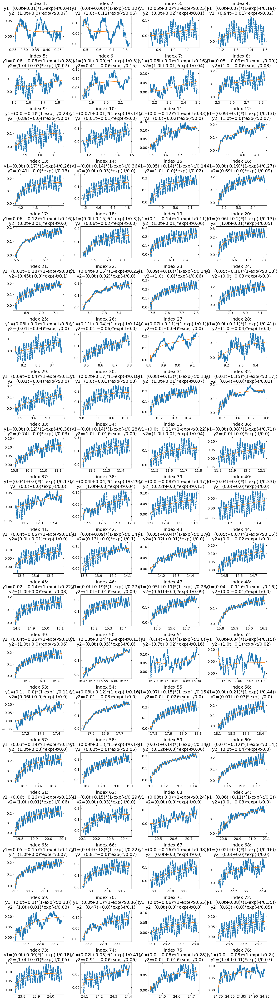

Fitting curves for raw data:


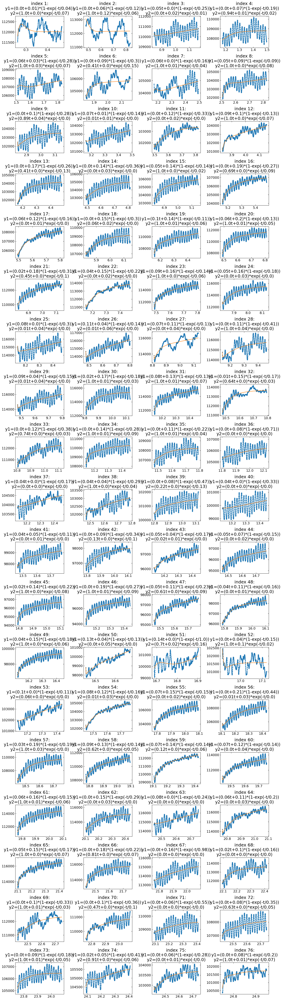

In [9]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
h5_para_file = '../../data/test6_gaussian_fit_parameters_all.h5'
visualize = True
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

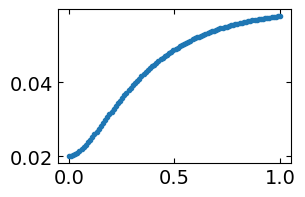

In [49]:
x = np.linspace(0,1,100)
y = 0.06*(1-np.exp(-x/0.3)) + 0.02*np.exp(-x/0.1)

plt.figure(figsize=(3, 2))
plt.plot(x, y, marker='.')
plt.show()

In [ ]:
x = np.linspace(0,1,100)
y = 0.06*(1-np.exp(-x/0.3)) + 0.02*np.exp(-x/0.1)

plt.figure(figsize=(3, 2))
plt.plot(x, y, marker='.')
plt.show()

## 4.2 Collect diffusion time constant for three samples

### 4.2.1 Treated substrate (step width=0.43±0.04μm)

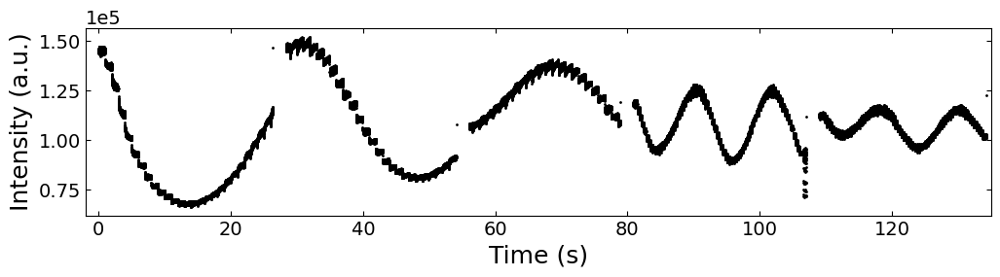

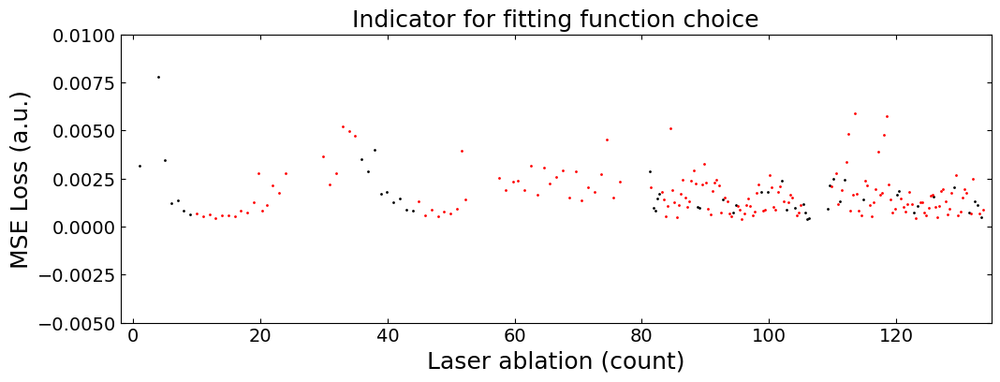

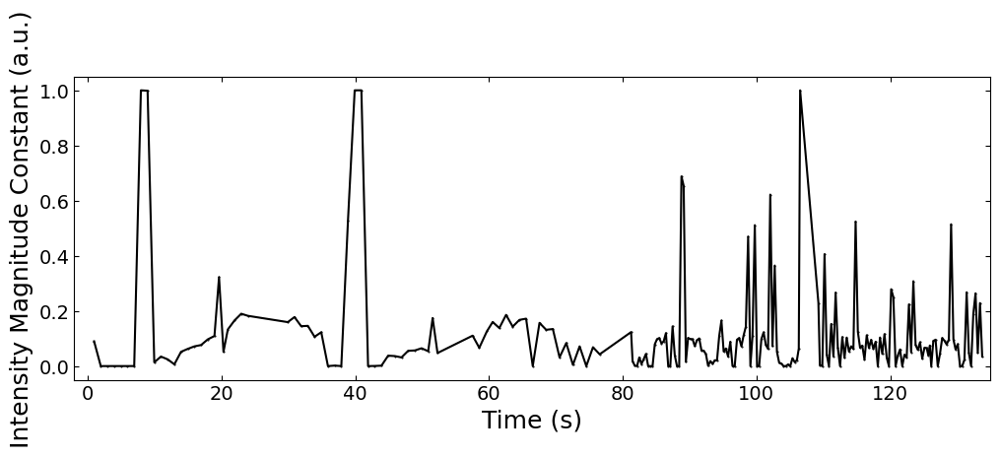

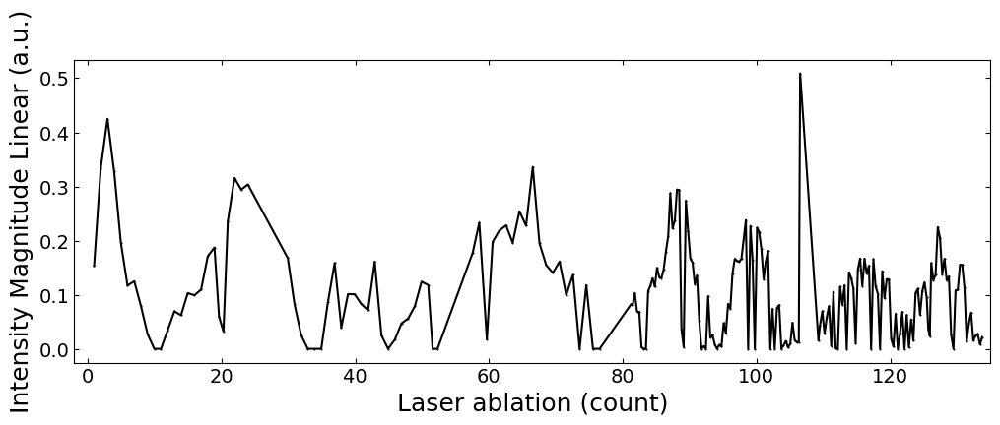

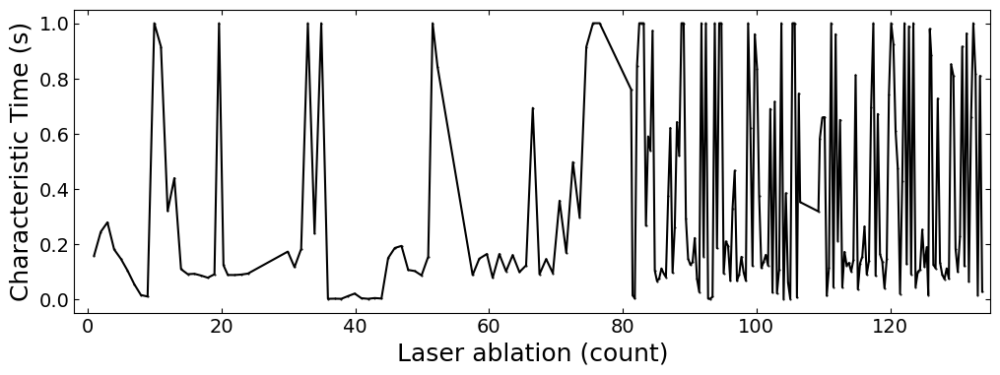

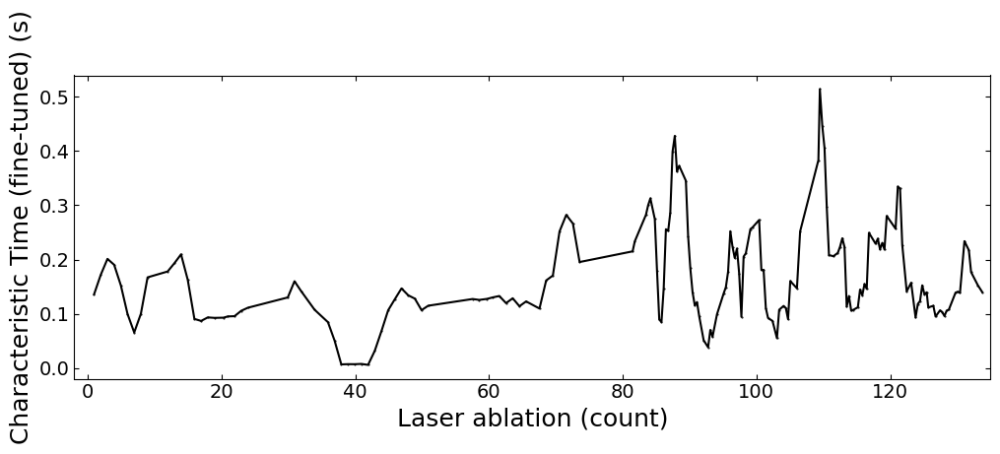

MSE loss for classic fitting is: 0.0018344077615937318


In [27]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
# growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1}
# growth_dict = {'growth_4':3, 'growth_5':3}
h5_para_file = '../../data/test6_gaussian_fit_parameters_all.h5'
visualize = False
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135), 
           save_path='../figures/test6_intensity.png')

x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
loss_y1 = losses_all[:,0][losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
loss_y2 = losses_all[:,1][losses_all[:,0]<losses_all[:,1]]
plot_curve(x_y1, loss_y1, curve_x_fit=x_y2, curve_y_fit=loss_y2, plot_type='scatter', xlim=(-2, 135), 
           ylim=(-0.005, 0.01), xlabel='Laser ablation (count)', ylabel='MSE Loss (a.u.)', yaxis_style='linear', 
           figsize=(12, 4), title='Indicator for fitting function choice', save_path='../figures/test6_indicator.svg')

plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135), save_path='../figures/test6_a_raw.svg')
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135), save_path='../figures/test6_b_raw.svg')
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135), save_path='../figures/test6_tau_raw.svg')

x_coor_all_clean, tau_test6_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
tau_test6_clean = smooth(tau_test6_clean, 5)
plot_curve(x_coor_all_clean, tau_test6_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135), 
           save_path='../figures/test6_tau.svg')
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test6_fitting_results(sklearn).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

In [17]:
sns.cubehelix_palette(4, rot = -0.25, light = 0.7)

[[0.5632111255041908, 0.758620966612444, 0.7764634182455044],
 [0.3781016811140187, 0.5633546614344814, 0.6530658354036274],
 [0.2426591079772084, 0.3511228226876375, 0.4852103253459974],
 [0.12071162840208301, 0.14526386650440642, 0.2463679091477368]]

### 4.2.2 Treated substrate (step width=0.11±0.01μm)

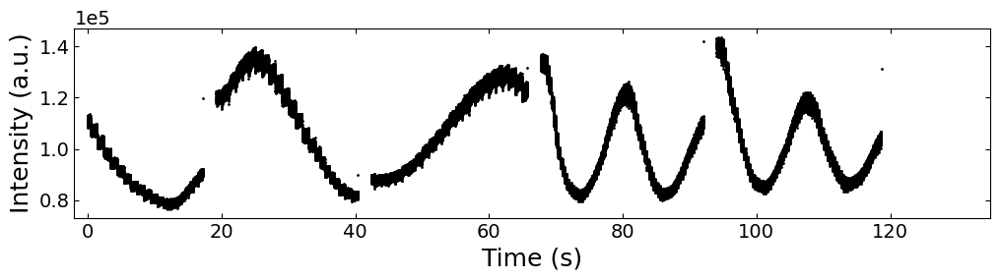

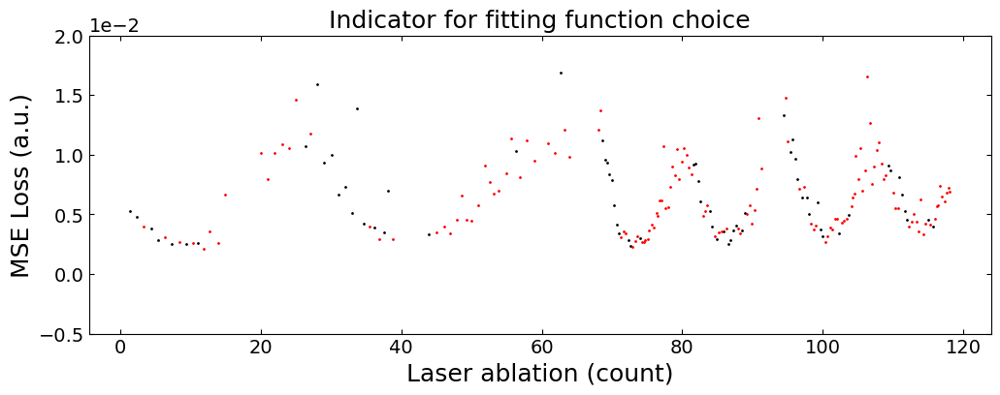

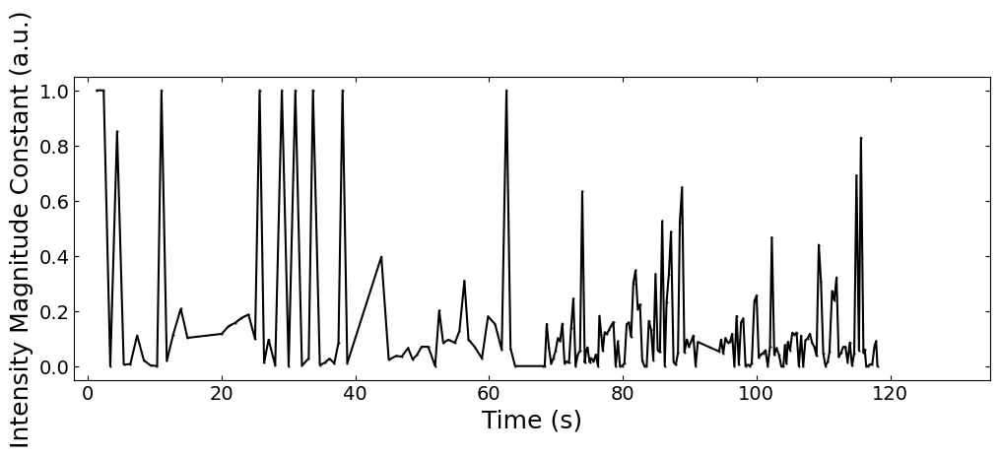

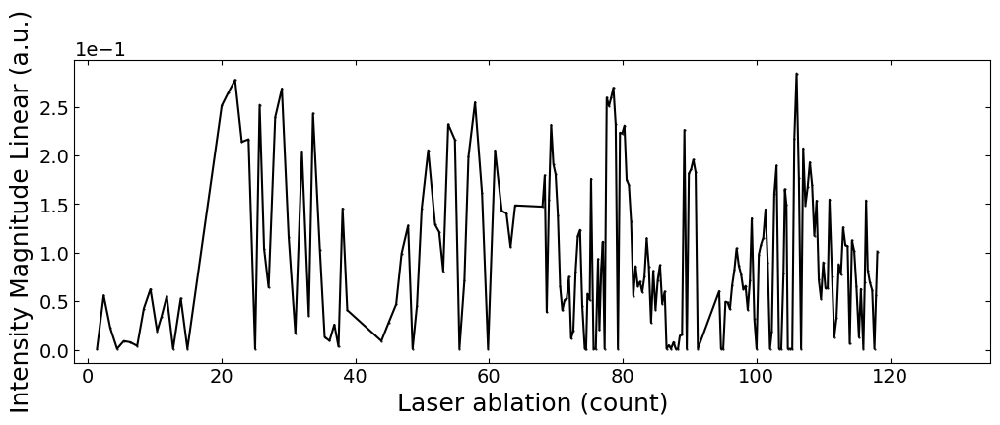

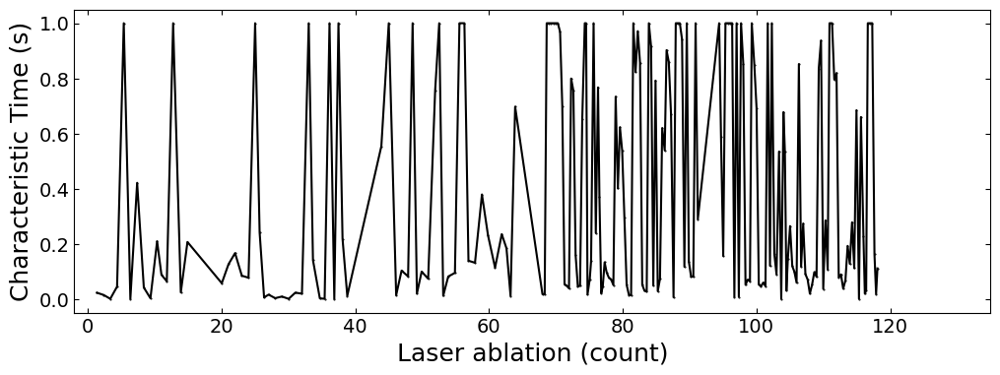

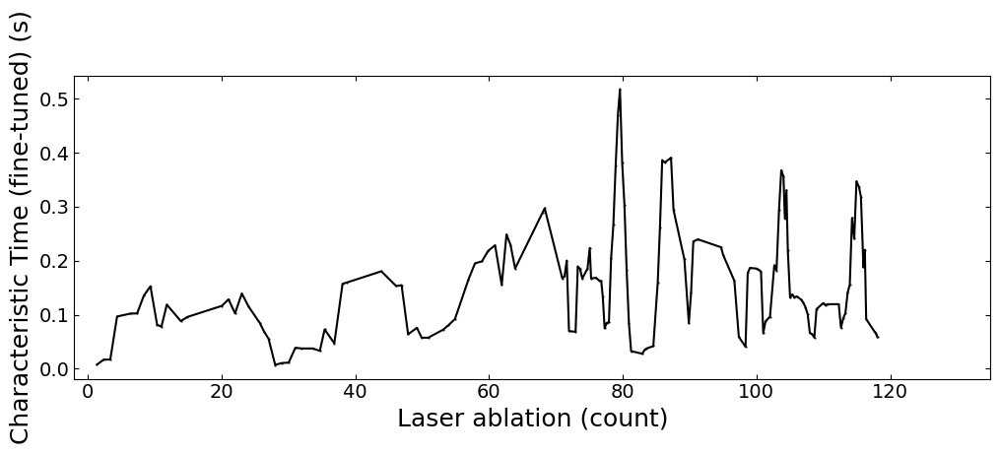

MSE loss for classic fitting is: 0.00605730845731335


In [38]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
# growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1}
# growth_dict = {'growth_4':3, 'growth_5':3}
h5_para_file = '../../data/test7_gaussian_fit_parameters_all.h5'
visualize = False
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info
plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135))

x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
loss_y1 = losses_all[:,0][losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
loss_y2 = losses_all[:,1][losses_all[:,0]<losses_all[:,1]]
plot_curve(x_y1, loss_y1, curve_x_fit=x_y2, curve_y_fit=loss_y2, plot_type='scatter', ylim=(-0.005, 0.02),
           xlabel='Laser ablation (count)', ylabel='MSE Loss (a.u.)', yaxis_style='sci', 
           figsize=(12, 4), title='Indicator for fitting function choice')

plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='sci', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='sci', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='sci', figsize=(12, 4), xlim=(-2, 135))

x_coor_all_clean, tau_test7_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
tau_test7_clean = smooth(tau_test7_clean, 5)
plot_curve(x_coor_all_clean, tau_test7_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135), 
           save_path='../figures/test7_tau.svg')
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test7_fitting_results(sklearn).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

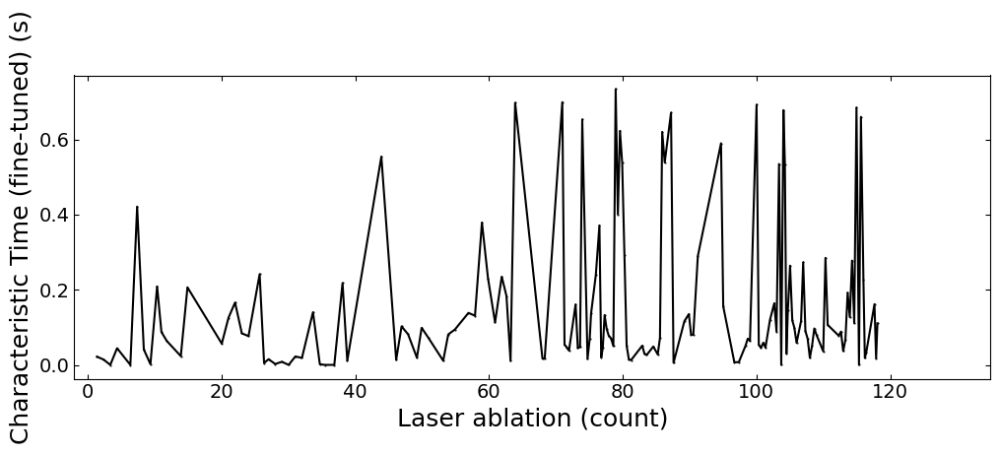

In [36]:
plot_curve(x_coor_all_clean, tau_test7_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135), 
           save_path='../figures/test7_tau.svg')

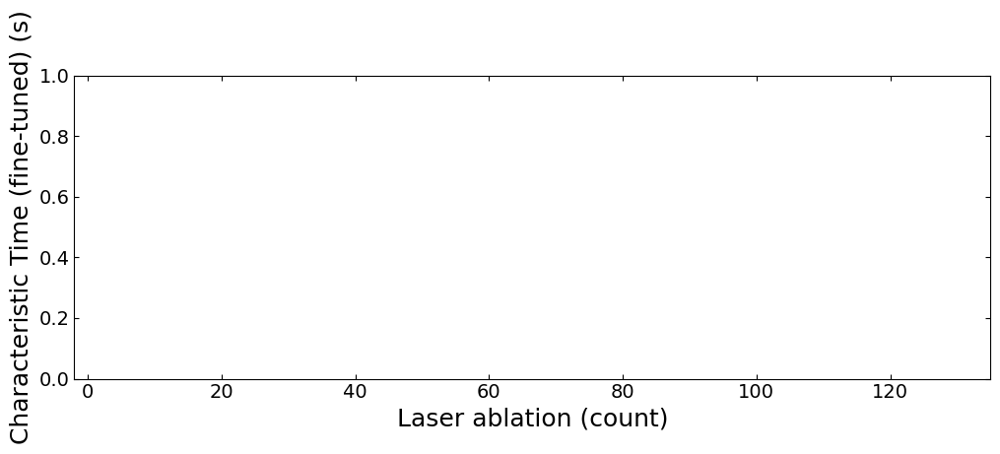

MSE loss for classic fitting is: 0.00605730845731335


In [34]:
x_coor_all_clean, tau_test7_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
plot_curve(x_coor_all_clean, tau_test7_clean, plot_type='linear', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))

### 4.2.3 Untreated substrate (step width=0.28±0.03μm)

growth_01 :


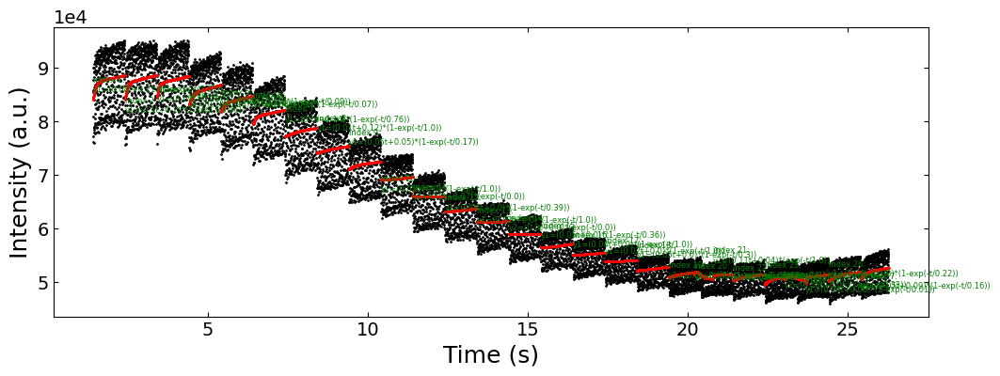

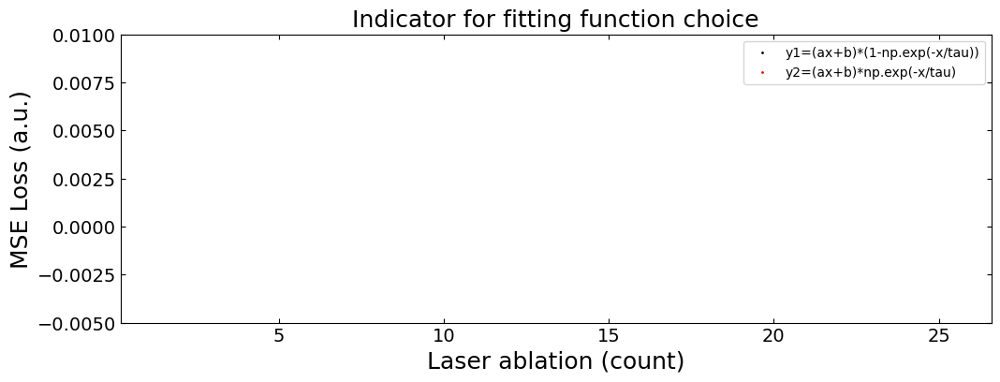

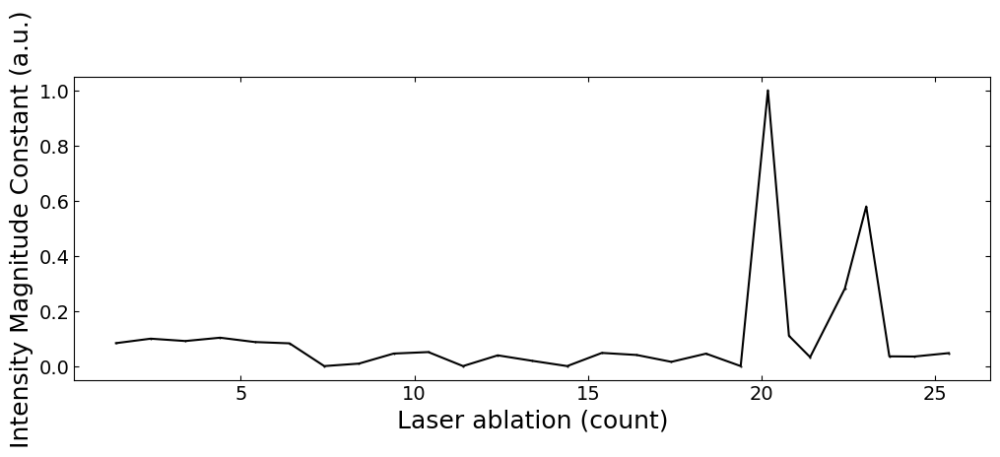

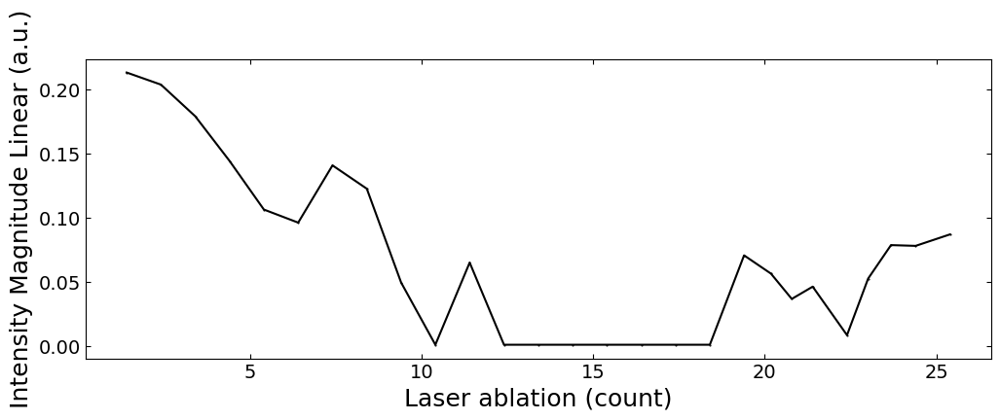

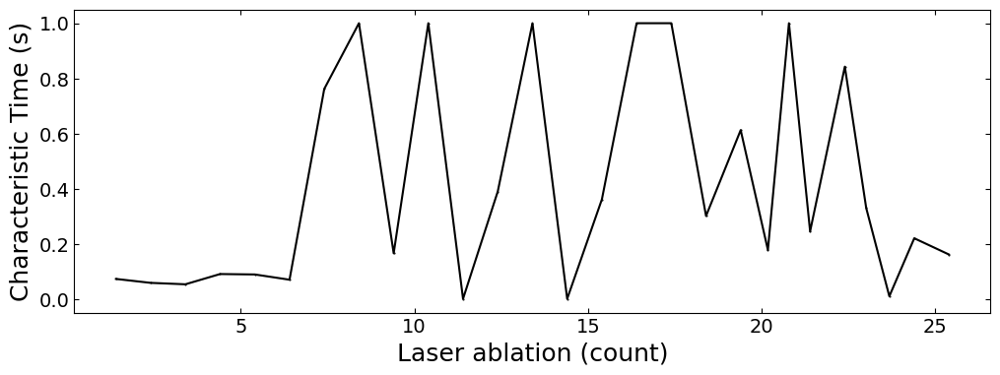

Fitting curves for normalized data:


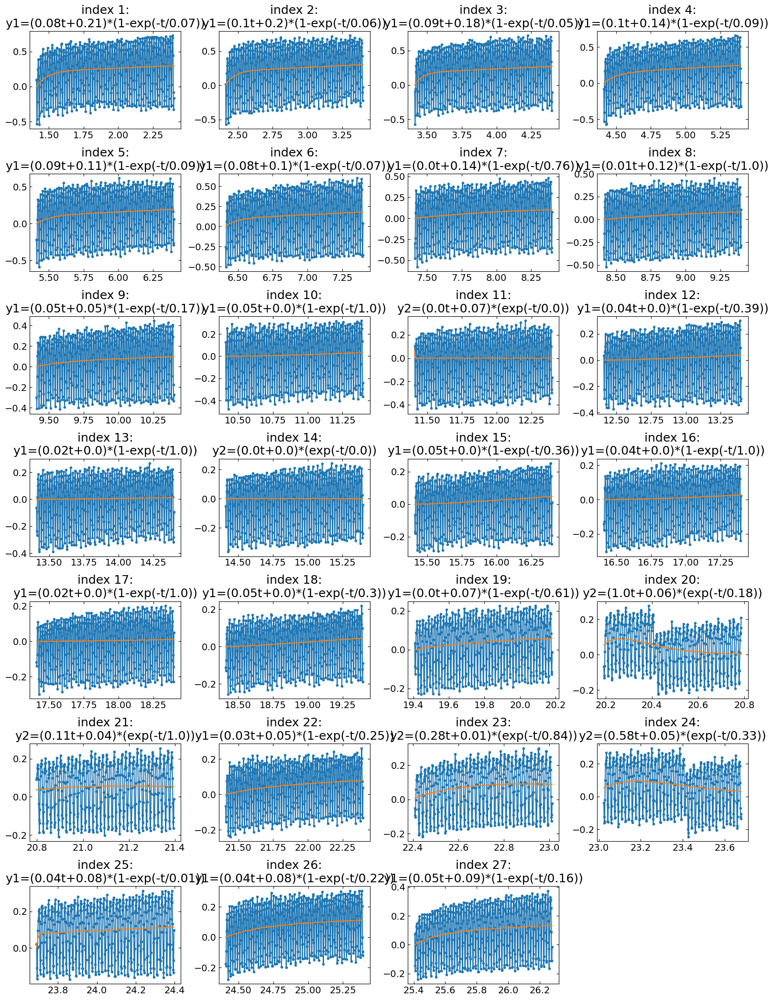

Fitting curves for raw data:


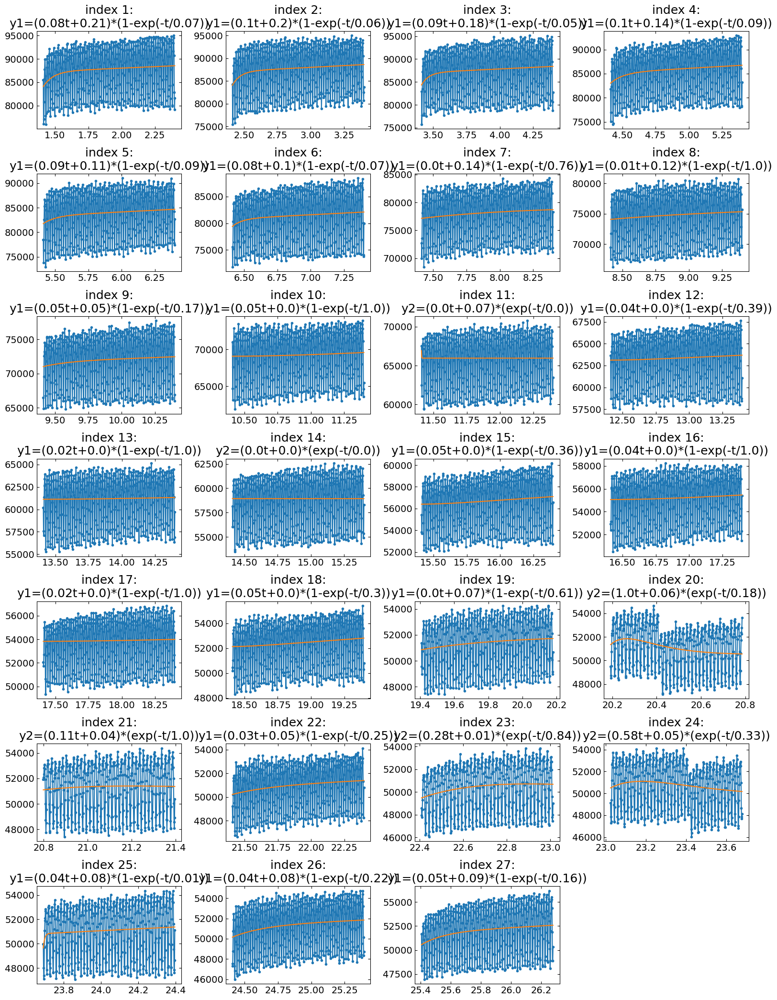

growth_02 :


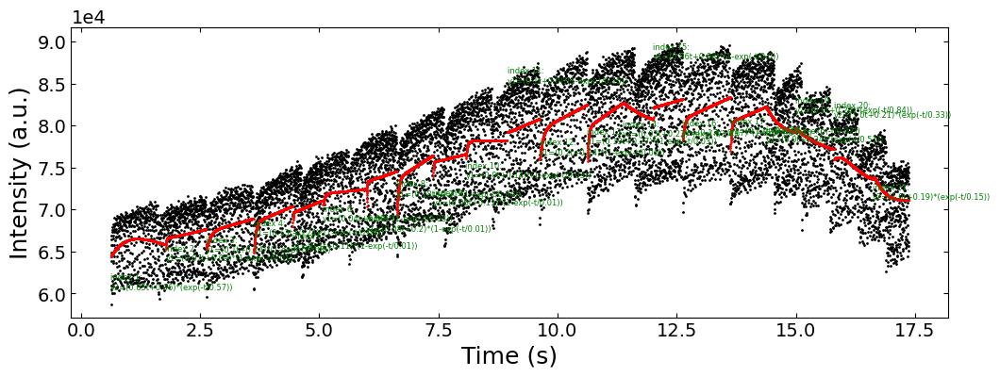

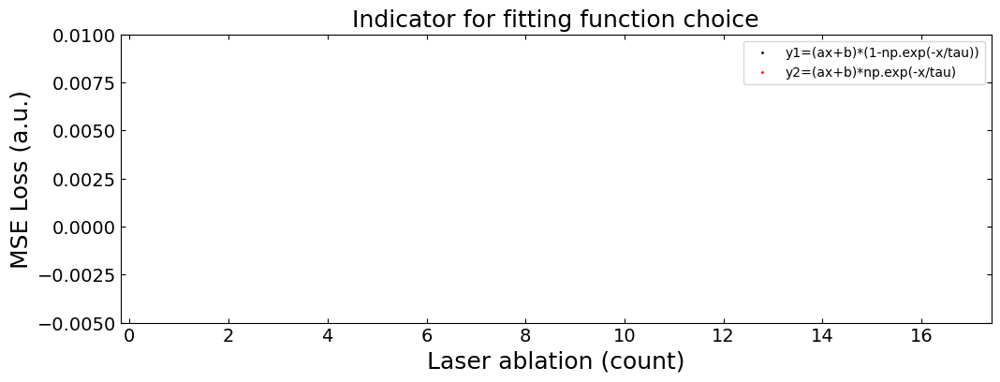

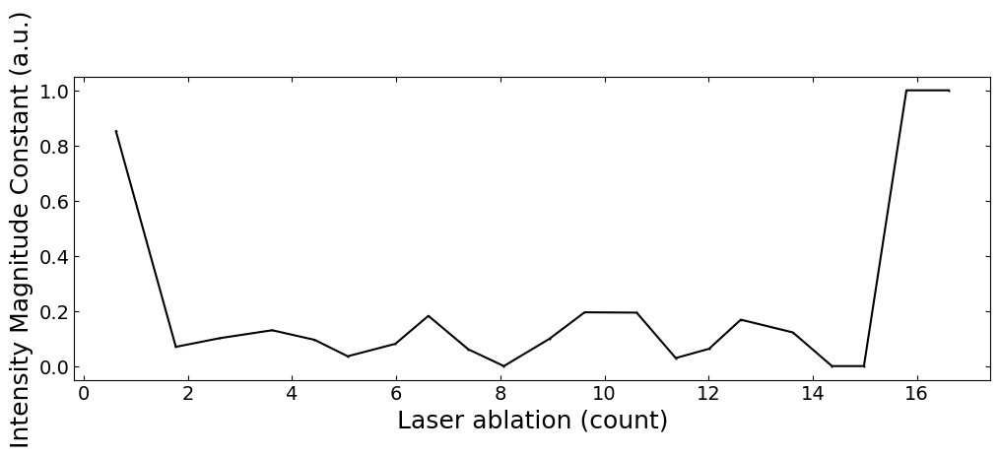

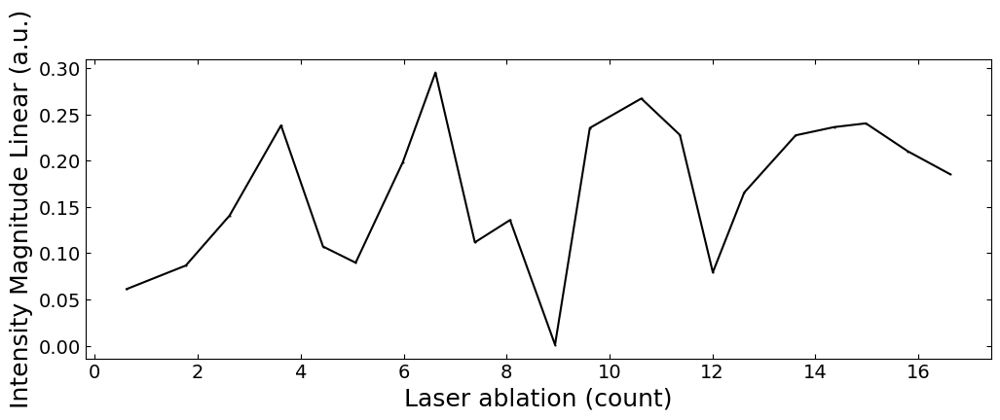

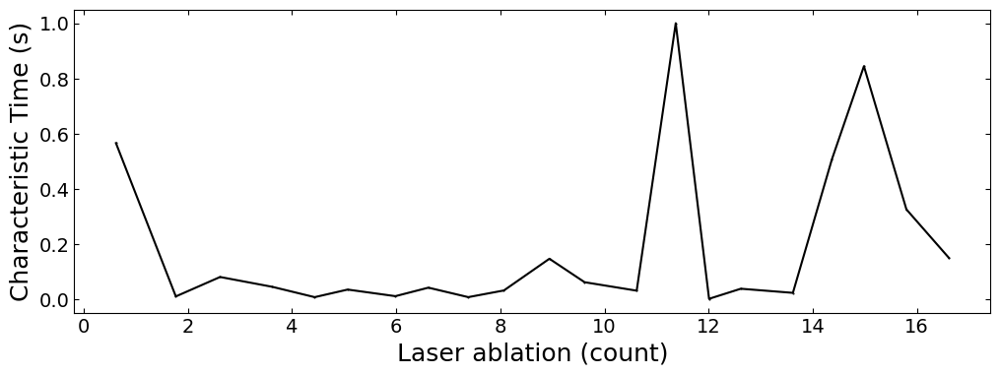

Fitting curves for normalized data:


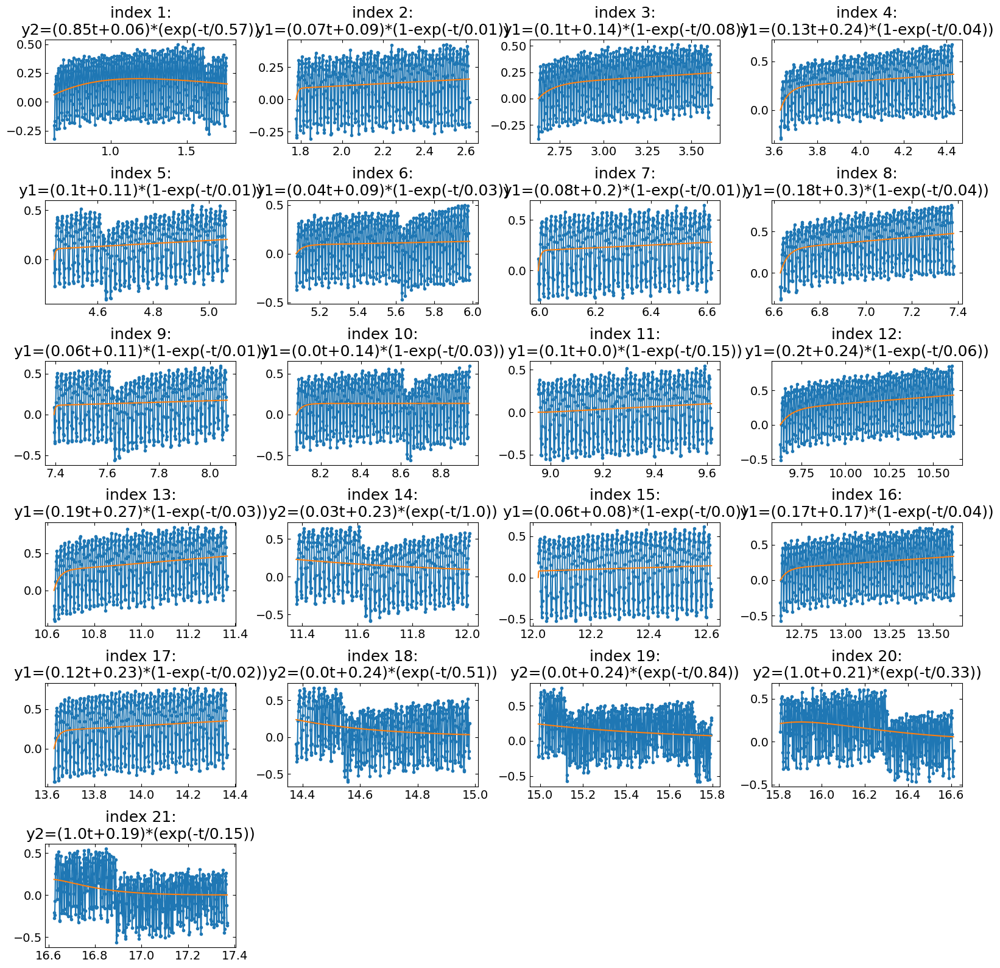

Fitting curves for raw data:


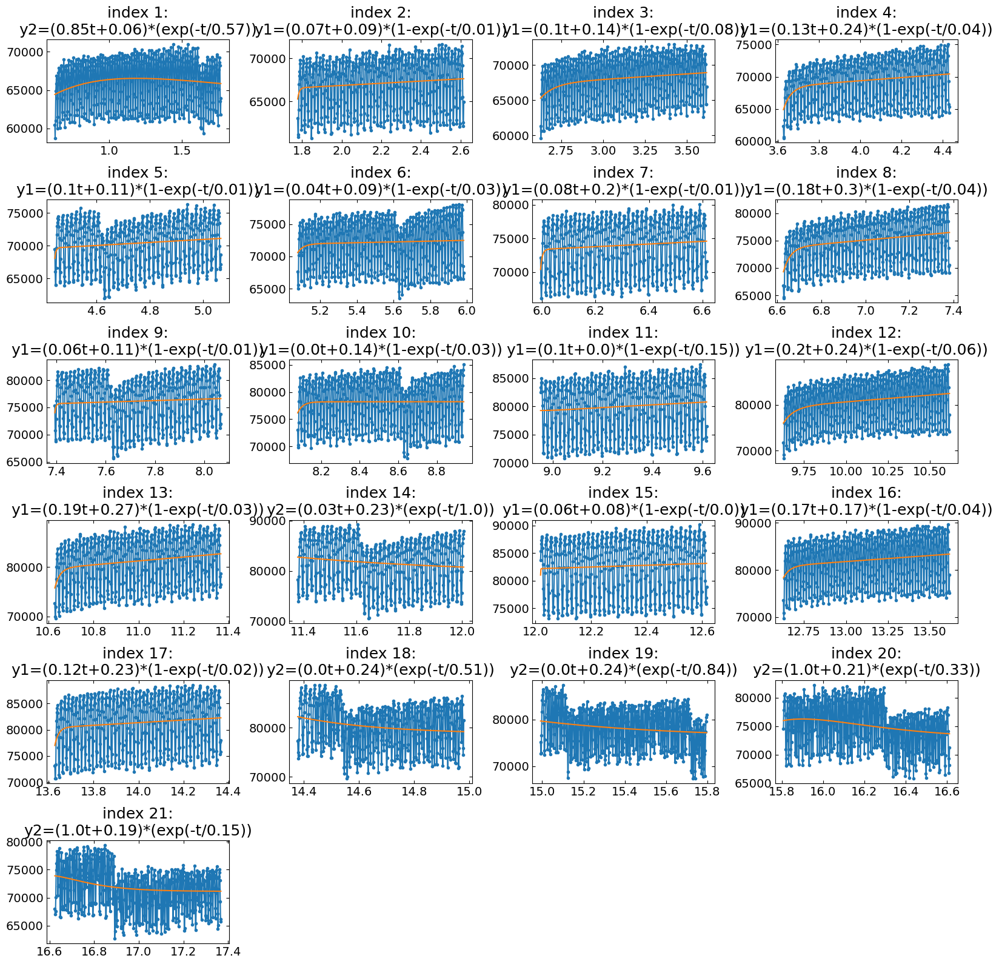

growth_03 :


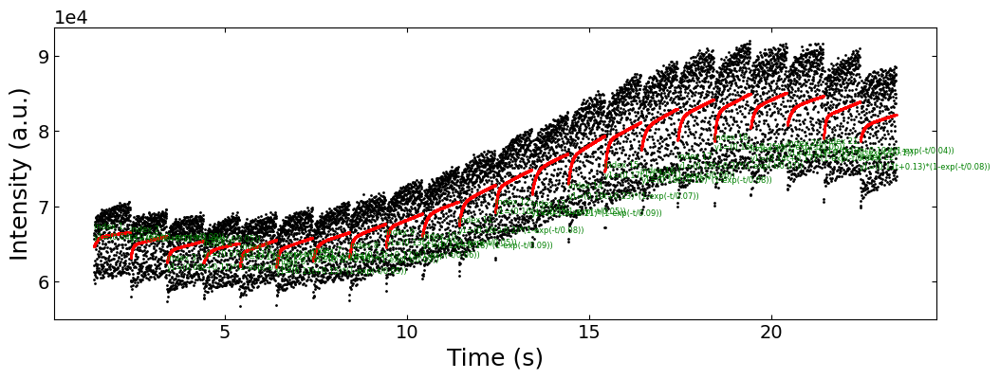

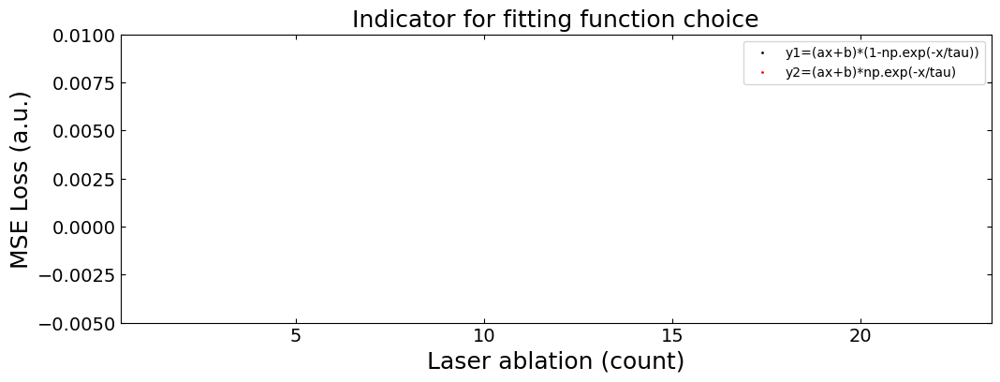

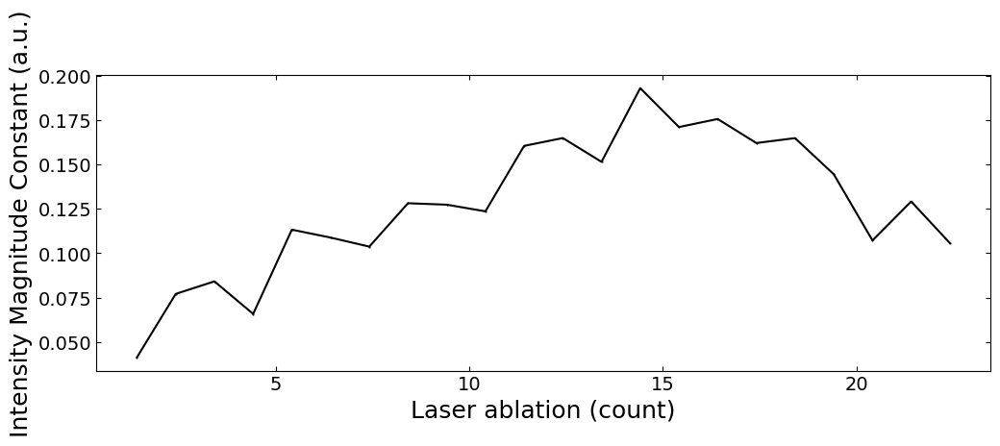

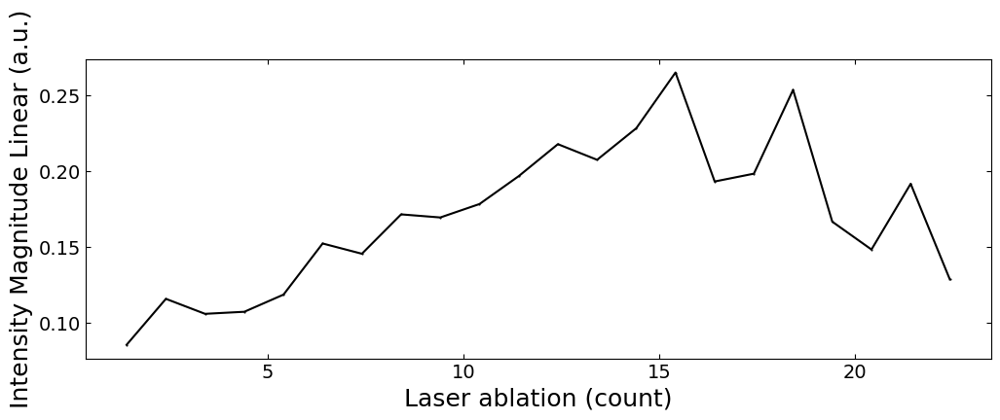

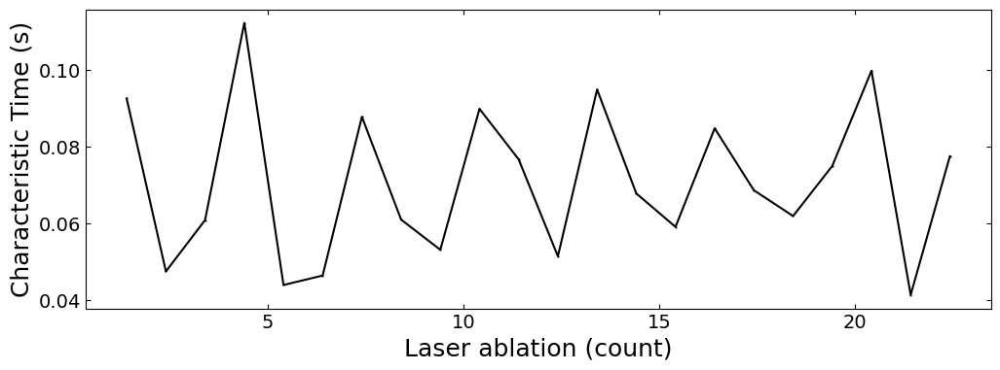

Fitting curves for normalized data:


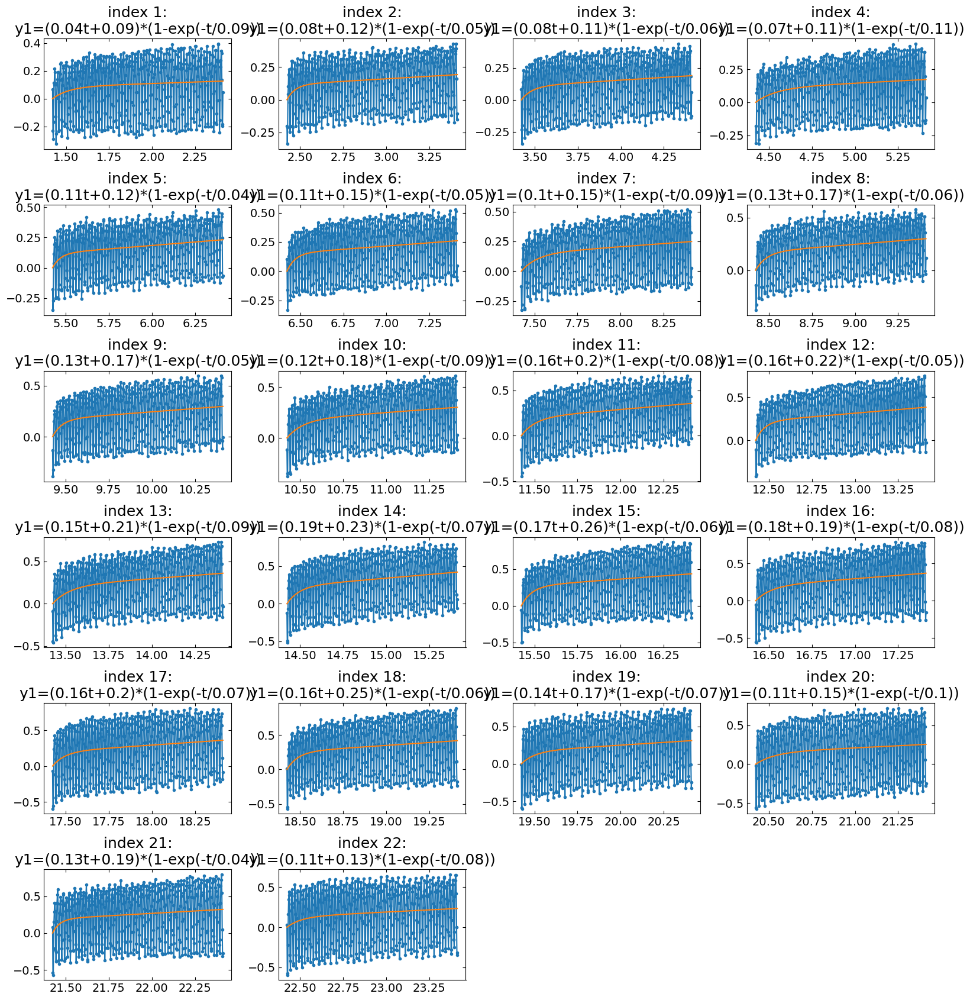

Fitting curves for raw data:


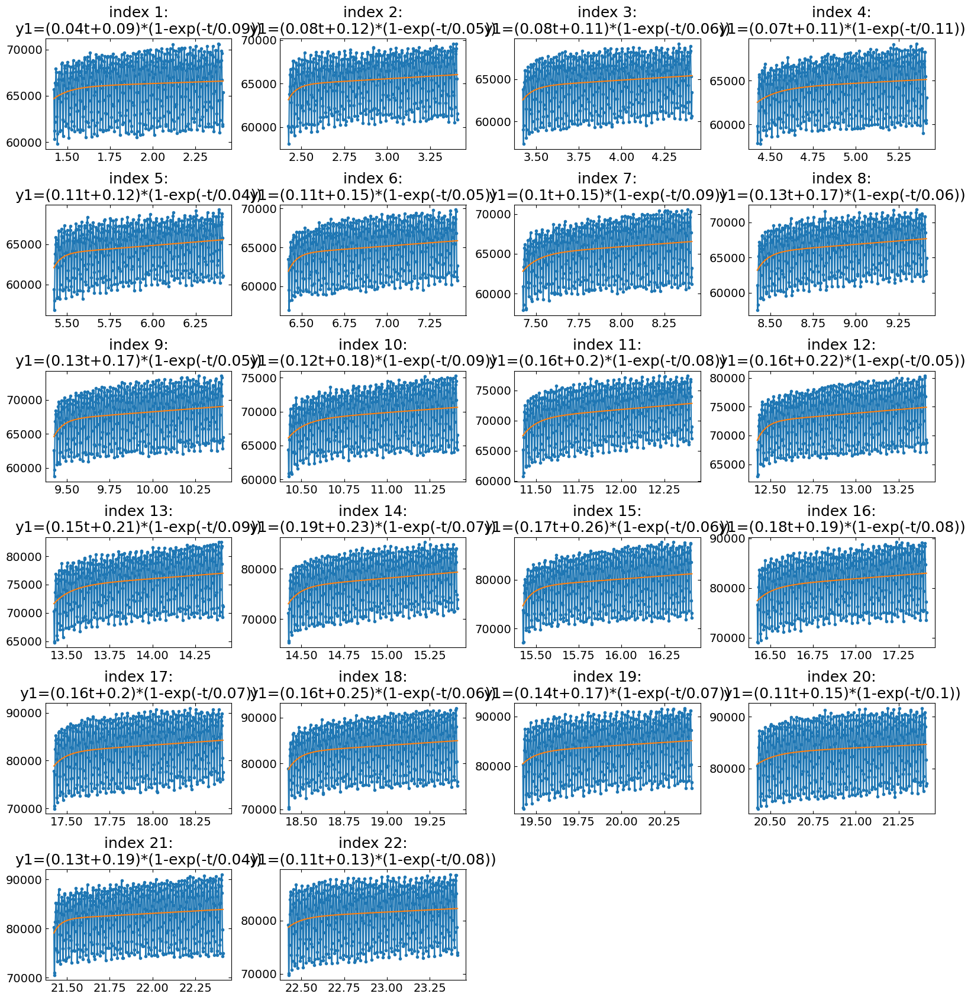

growth_04 :


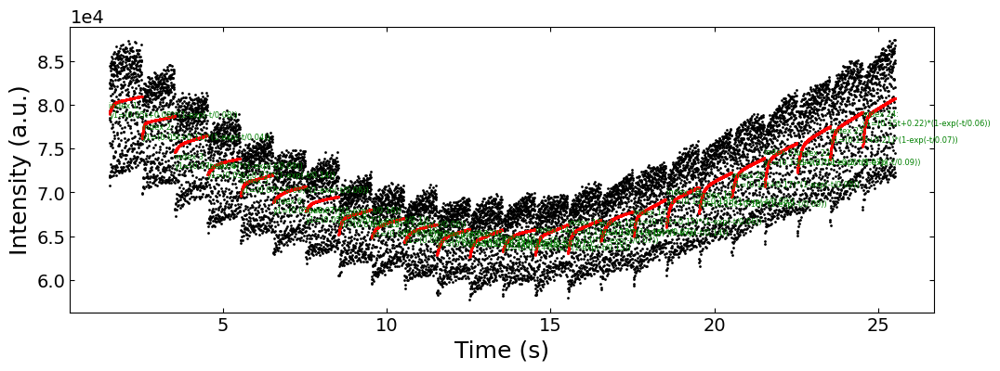

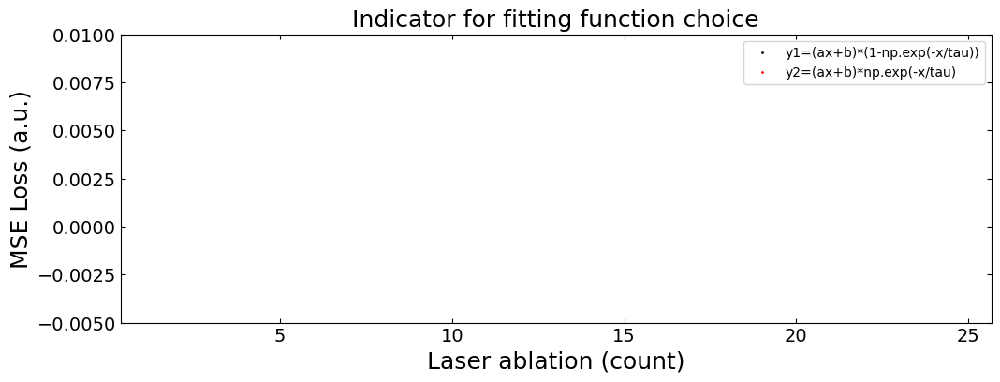

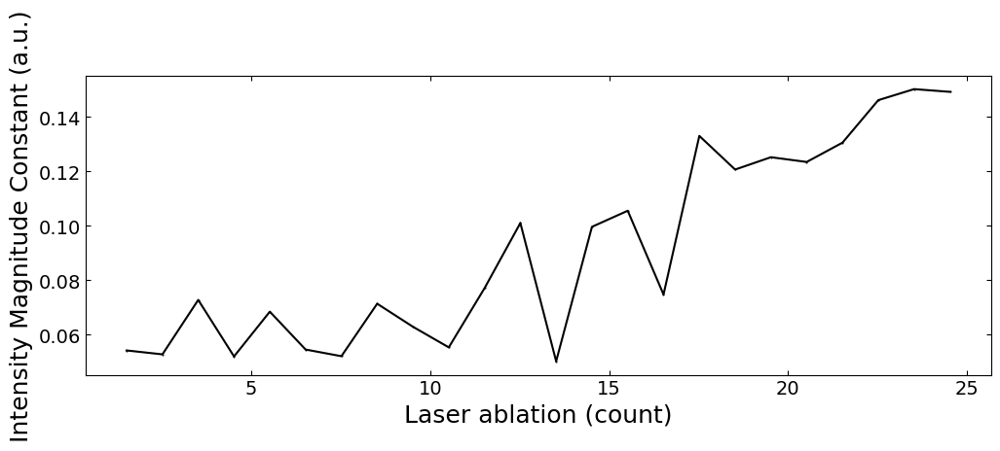

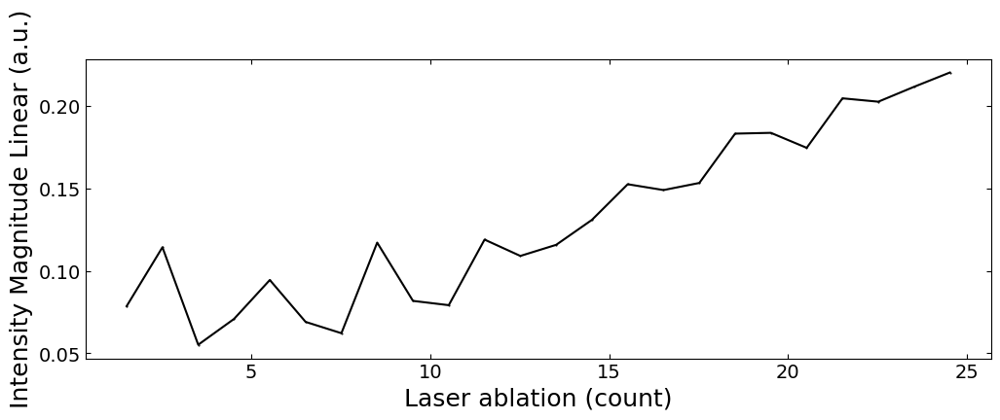

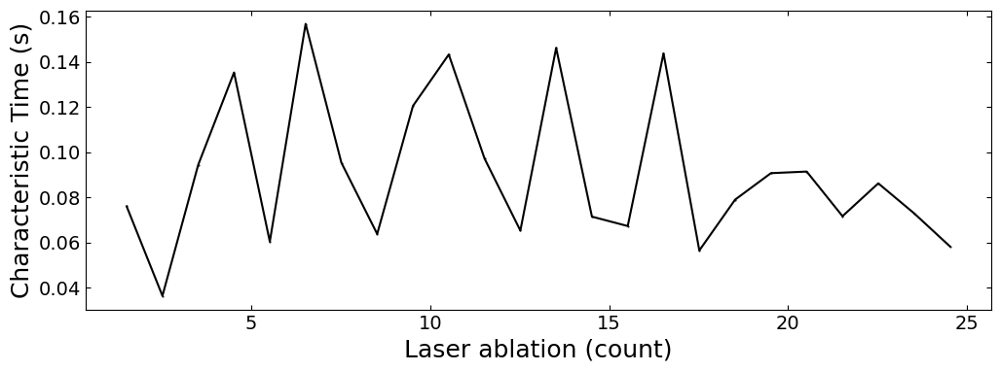

Fitting curves for normalized data:


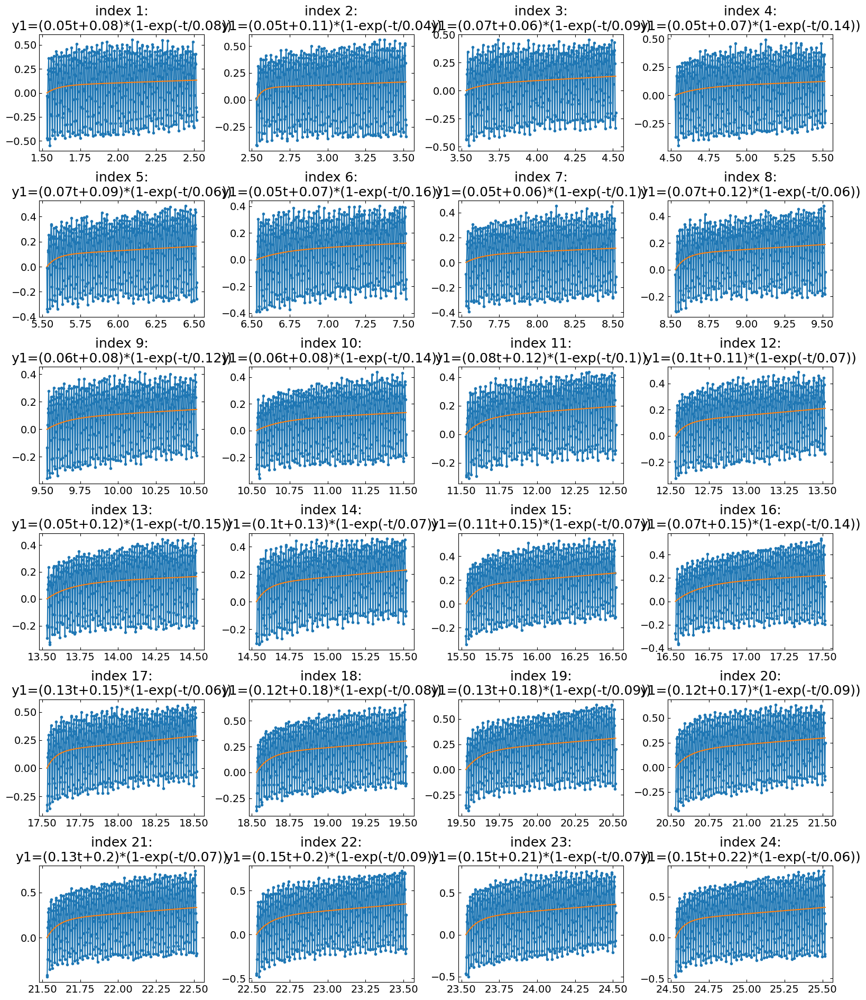

Fitting curves for raw data:


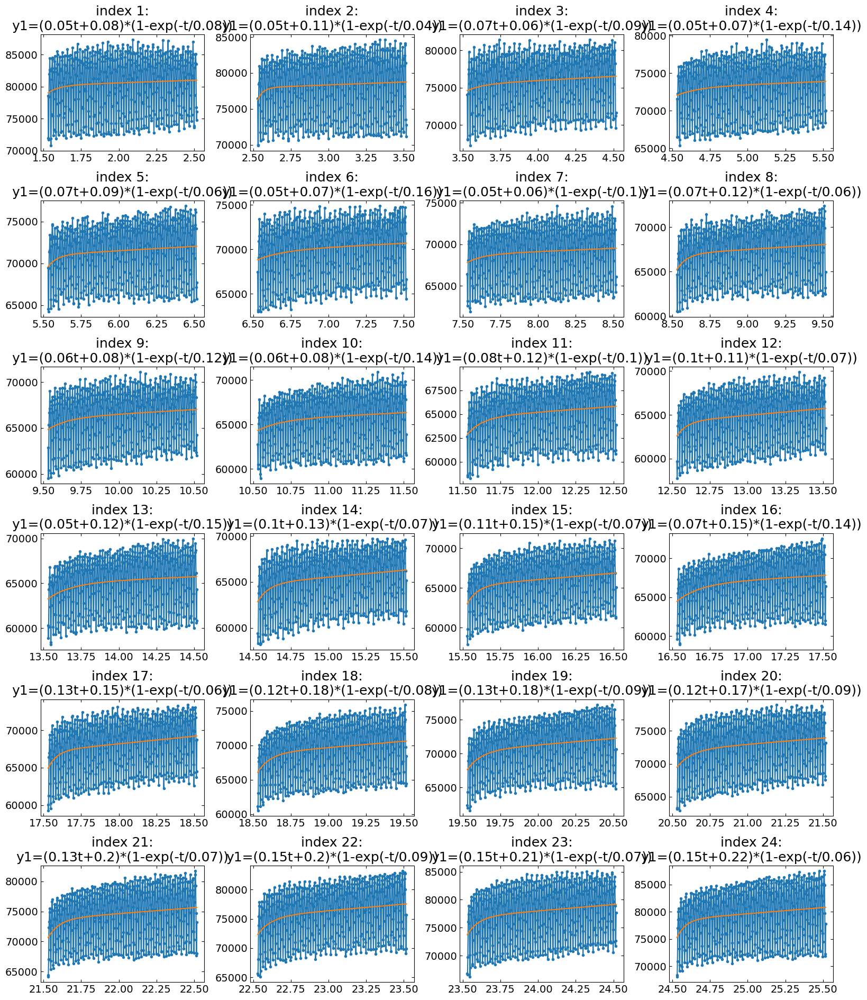

growth_05 :


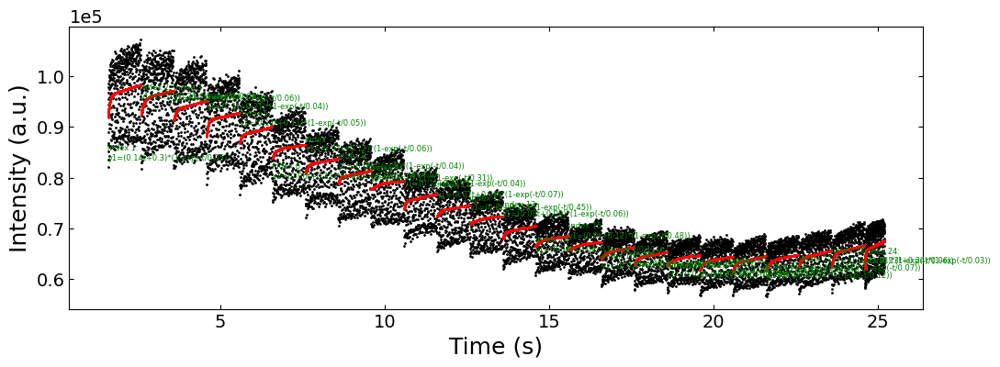

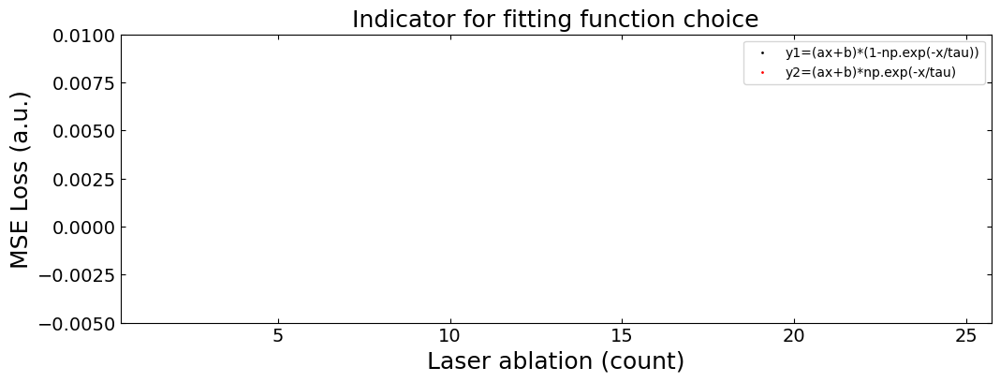

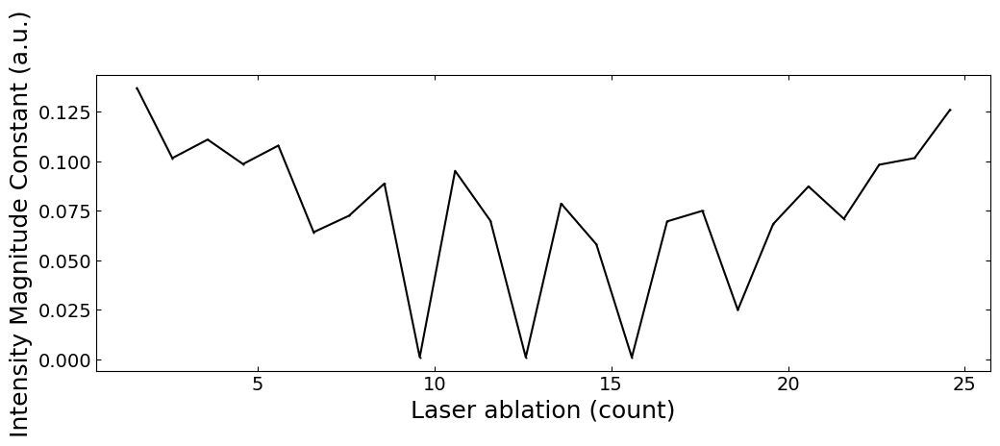

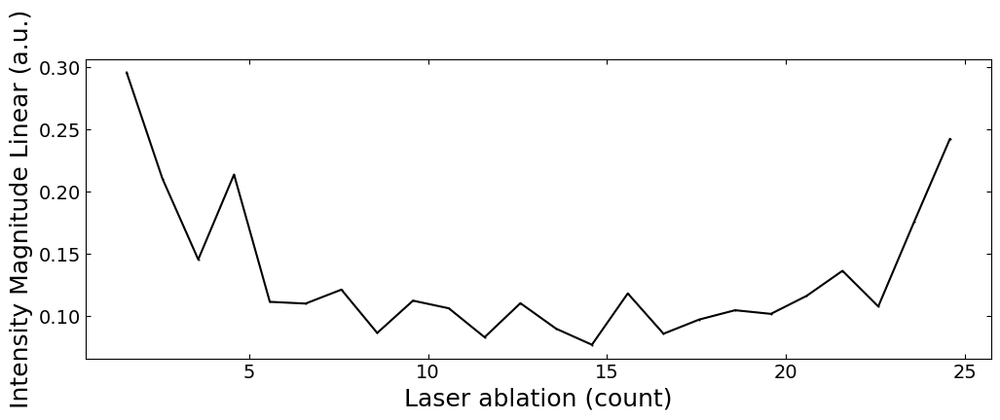

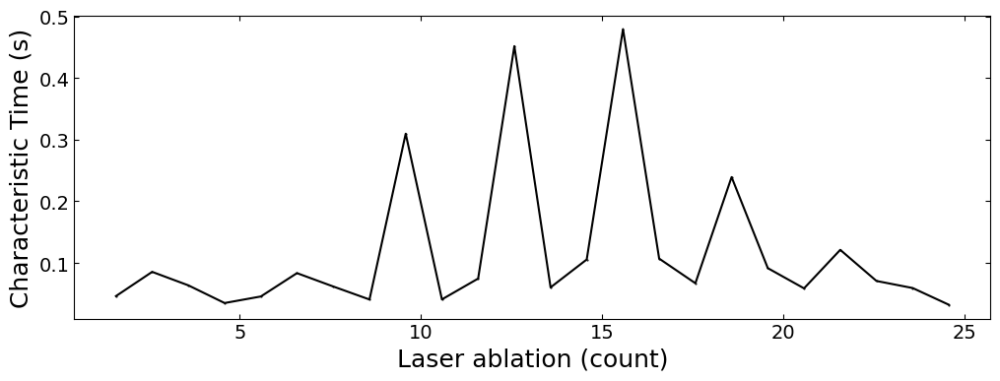

Fitting curves for normalized data:


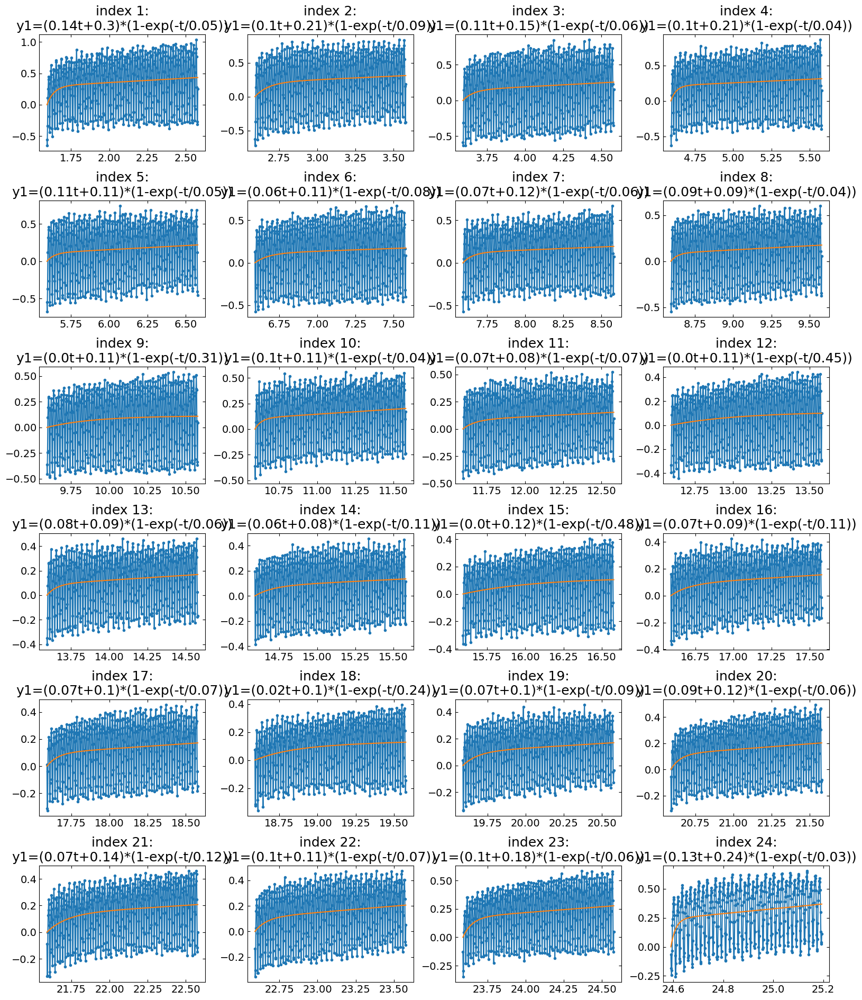

Fitting curves for raw data:


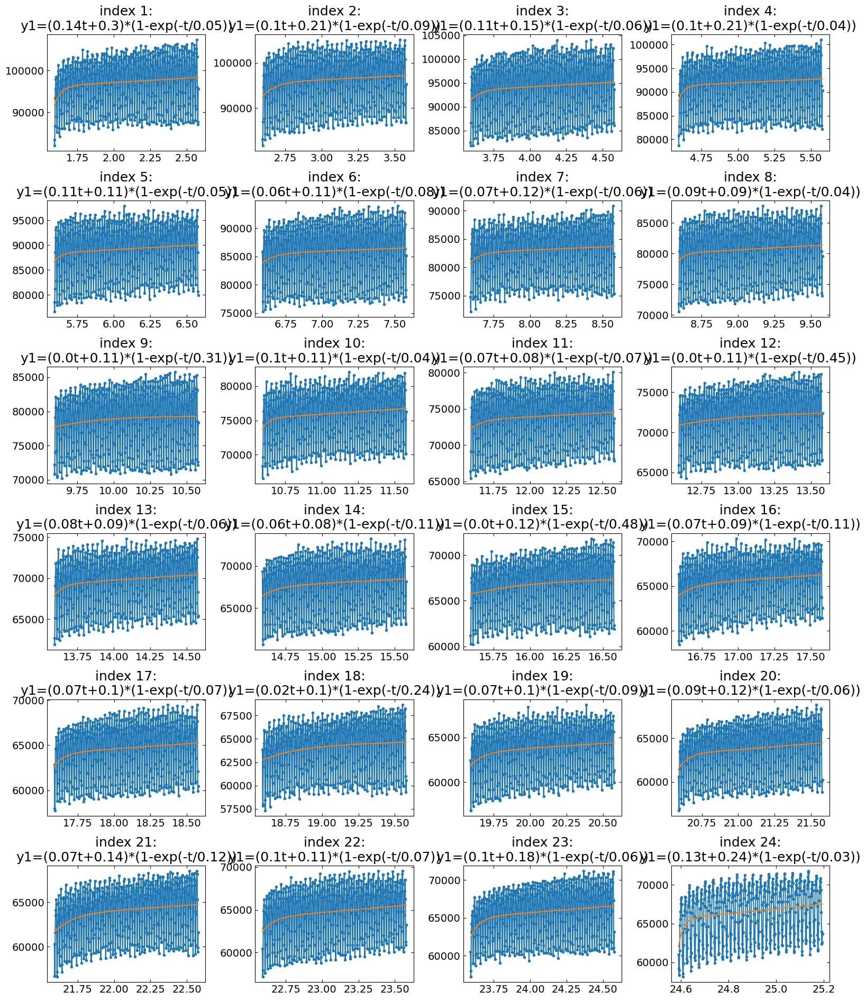

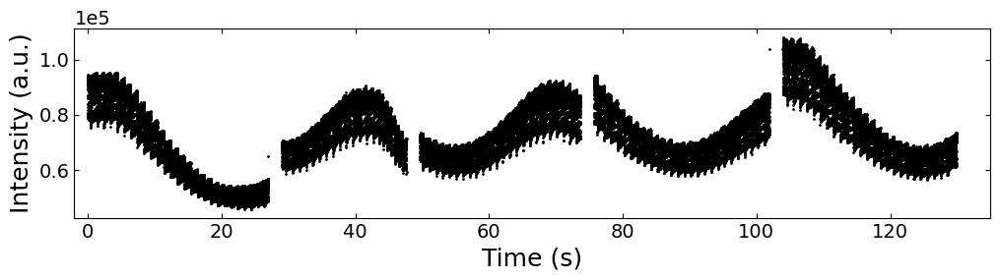

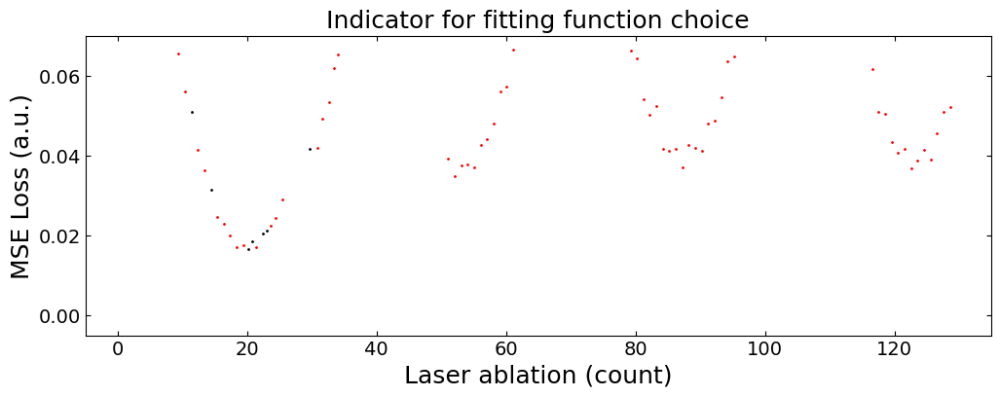

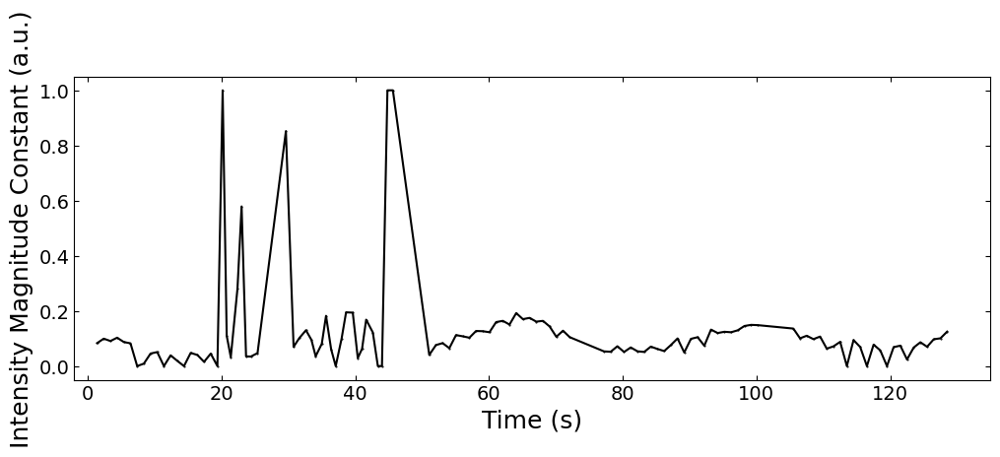

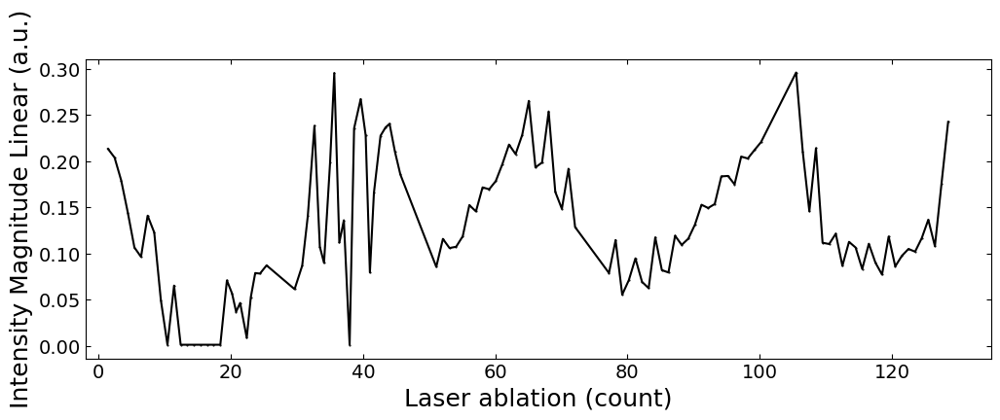

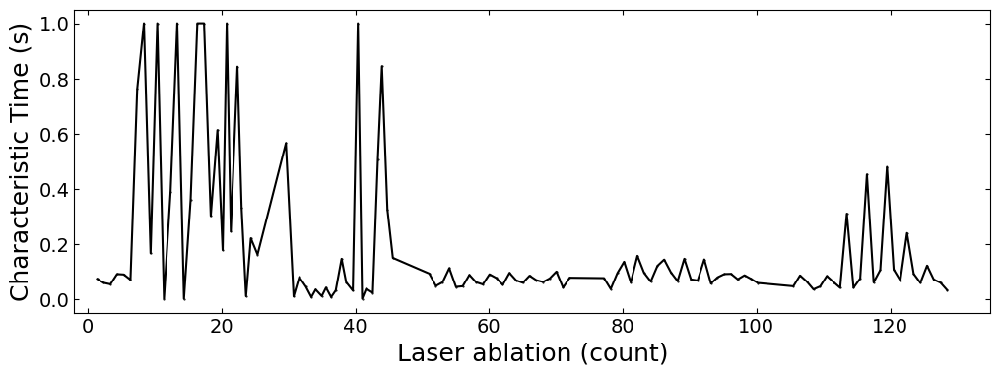

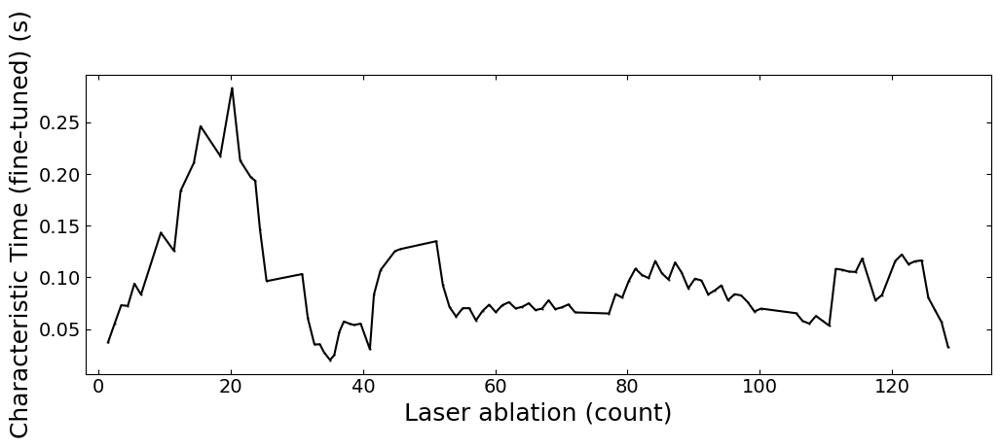

MSE loss for classic fitting is: 0.07069496256854542


In [26]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_01':1, 'growth_02':1, 'growth_03':1, 'growth_04':1, 'growth_05':1}
h5_para_file = '../../data/test9_gaussian_fit_parameters_all.h5'
visualize = True
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135))

x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
loss_y1 = losses_all[:,0][losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
loss_y2 = losses_all[:,1][losses_all[:,0]<losses_all[:,1]]
plot_curve(x_y1, loss_y1, curve_x_fit=x_y2, curve_y_fit=loss_y2, plot_type='scatter', ylim=(-0.005, 0.07),
           xlabel='Laser ablation (count)', ylabel='MSE Loss (a.u.)', yaxis_style='linear', 
           figsize=(12, 4), title='Indicator for fitting function choice')

plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))

x_coor_all_clean, tau_test6_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
tau_test6_clean = smooth(tau_test6_clean, 5)
plot_curve(x_coor_all_clean, tau_test6_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test9_fitting_results(sklearn).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

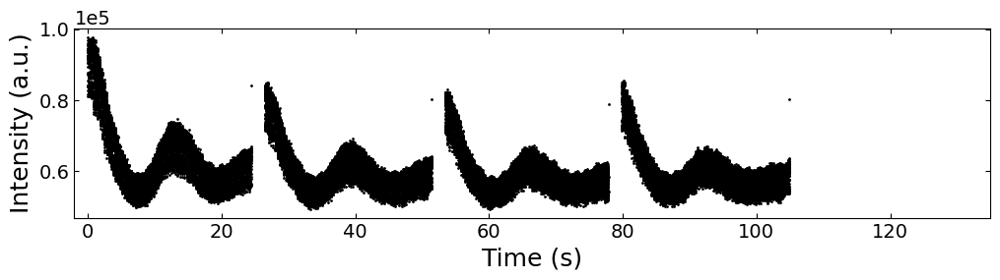

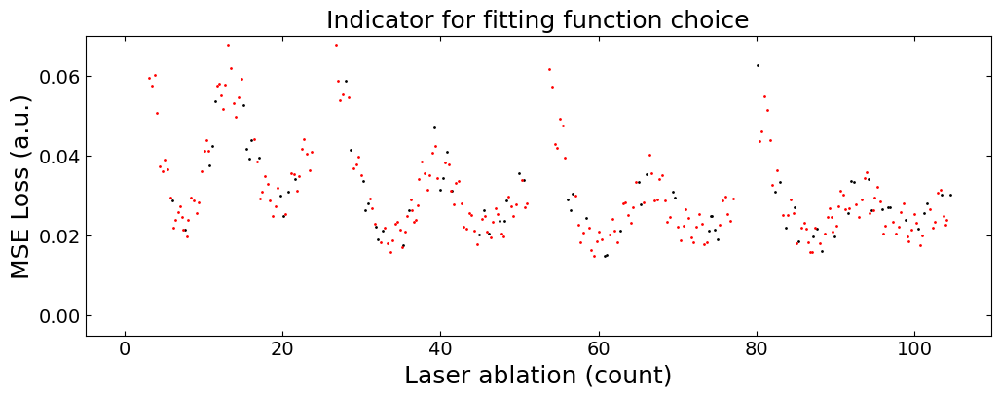

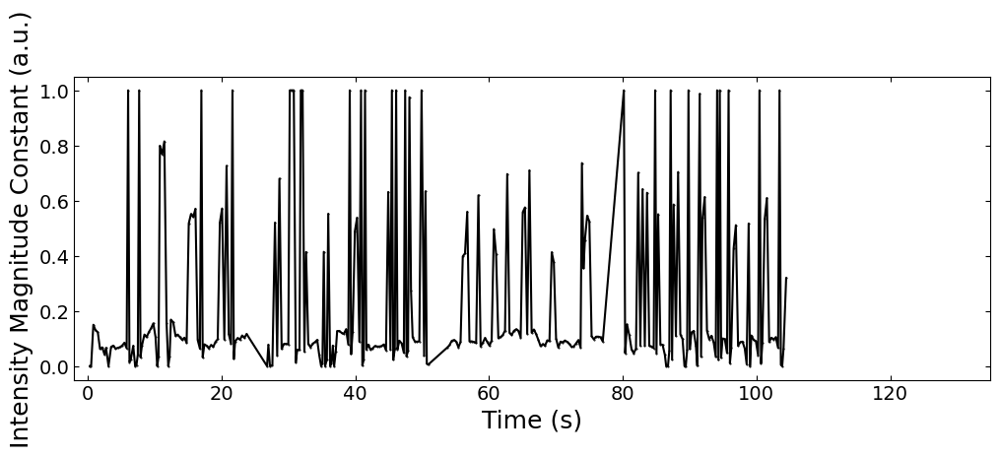

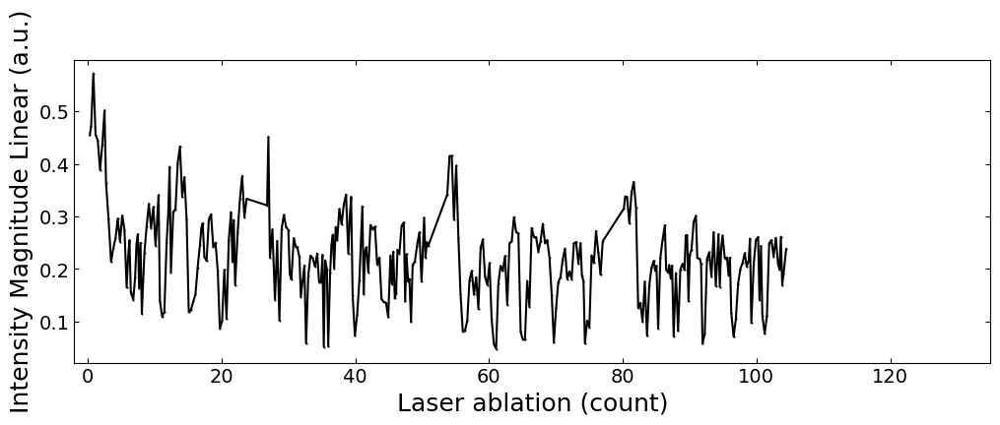

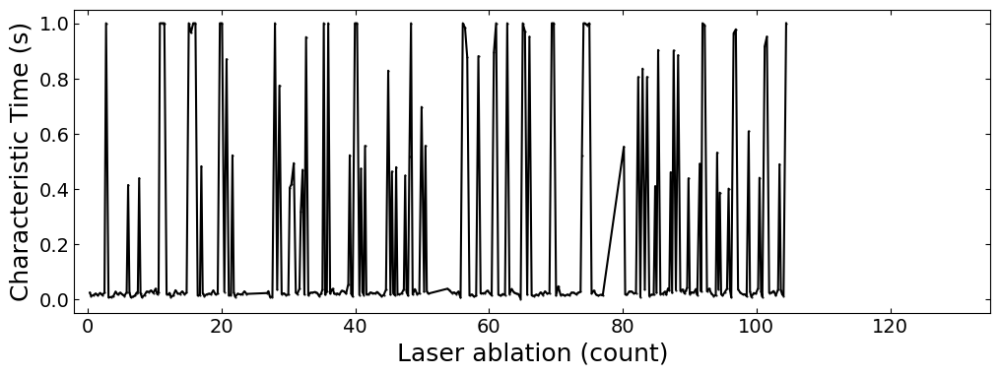

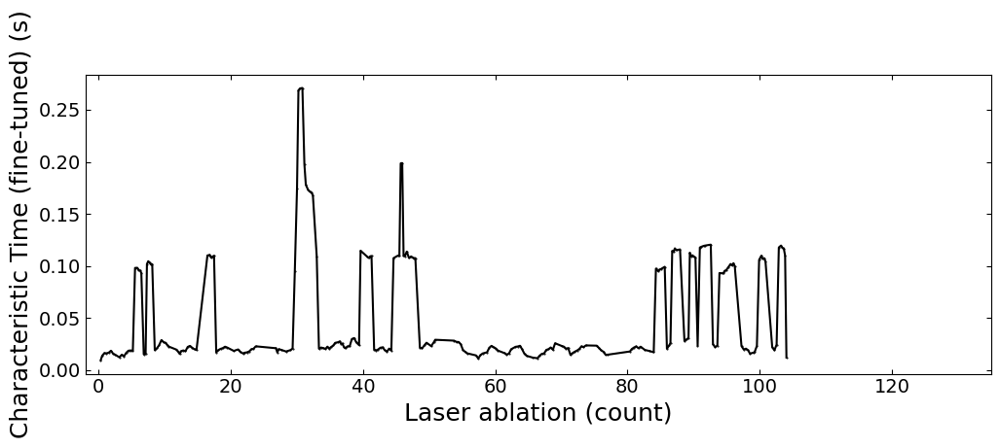

MSE loss for classic fitting is: 0.03175827927137402


In [24]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_09':3, 'growth_10':3, 'growth_11':3, 'growth_12':3}
h5_para_file = '../../data/test9_gaussian_fit_parameters_all.h5'
visualize = False
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135))

x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
loss_y1 = losses_all[:,0][losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
loss_y2 = losses_all[:,1][losses_all[:,0]<losses_all[:,1]]
plot_curve(x_y1, loss_y1, curve_x_fit=x_y2, curve_y_fit=loss_y2, plot_type='scatter', ylim=(-0.005, 0.07),
           xlabel='Laser ablation (count)', ylabel='MSE Loss (a.u.)', yaxis_style='linear', 
           figsize=(12, 4), title='Indicator for fitting function choice')

plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))

x_coor_all_clean, tau_test6_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
tau_test6_clean = smooth(tau_test6_clean, 5)
plot_curve(x_coor_all_clean, tau_test6_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test9_fitting_results(sklearn).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

## 4.3 Summary of diffusion time constant

### 4.3.1 Violinplot 

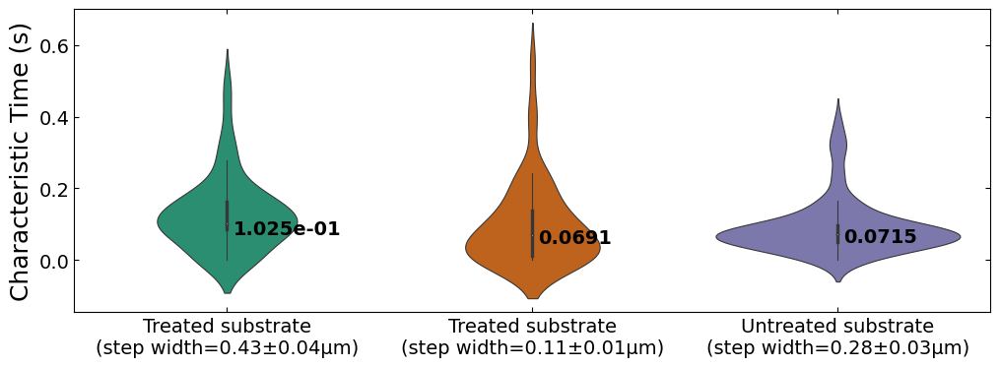

In [21]:
x_test6_sklearn, tau_test6_sklearn = np.swapaxes(np.load('../saved_data/test6_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test7_sklearn, tau_test7_sklearn = np.swapaxes(np.load('../saved_data/test7_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test9_sklearn, tau_test9_sklearn = np.swapaxes(np.load('../saved_data/test9_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]

x_test6_sklearn, tau_test6_sklearn = remove_outlier(x_test6_sklearn, tau_test6_sklearn, 0.9)
x_test7_sklearn, tau_test7_sklearn = remove_outlier(x_test7_sklearn, tau_test7_sklearn, 0.9)
x_test9_sklearn, tau_test9_sklearn = remove_outlier(x_test9_sklearn, tau_test9_sklearn, 0.9)

data = [tau_test6_sklearn, tau_test7_sklearn, tau_test9_sklearn]
fig, ax = plt.subplots(figsize=(12, 4))

titles = ['Treated substrate\n(step width=0.43±0.04μm)',
          'Treated substrate\n(step width=0.11±0.01μm)',
          'Untreated substrate\n(step width=0.28±0.03μm)']
ax = sns.violinplot(data=data, palette=[color_green, color_orange, color_purple], linewidth=0.8)
ax.set_xticklabels(titles)

label_violinplot(ax, data, label_type='average', text_pos='right')
ax.set_ylabel('Characteristic Time (s)')
plt.savefig('../figures/4.violinplot_plot(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()

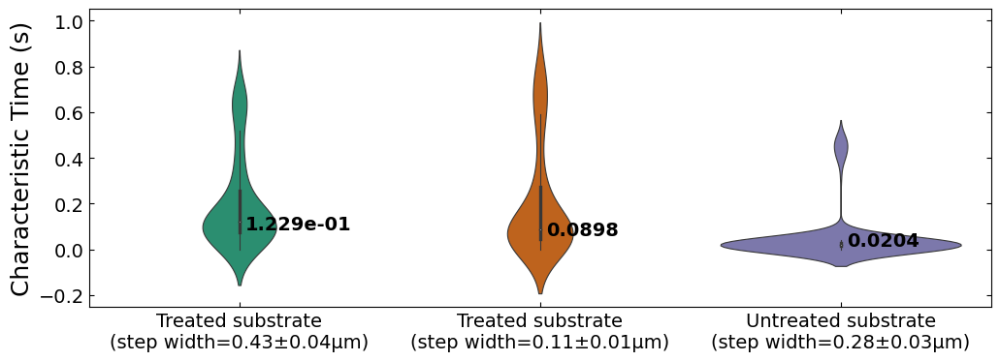

In [25]:
x_test6_sklearn, tau_test6_sklearn = np.swapaxes(np.load('../saved_data/test6_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test7_sklearn, tau_test7_sklearn = np.swapaxes(np.load('../saved_data/test7_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test9_sklearn, tau_test9_sklearn = np.swapaxes(np.load('../saved_data/test9_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]

x_test6_sklearn, tau_test6_sklearn = remove_outlier(x_test6_sklearn, tau_test6_sklearn, 0.9)
x_test7_sklearn, tau_test7_sklearn = remove_outlier(x_test7_sklearn, tau_test7_sklearn, 0.9)
x_test9_sklearn, tau_test9_sklearn = remove_outlier(x_test9_sklearn, tau_test9_sklearn, 0.9)

data = [tau_test6_sklearn, tau_test7_sklearn, tau_test9_sklearn]
fig, ax = plt.subplots(figsize=(12, 4))

titles = ['Treated substrate\n(step width=0.43±0.04μm)',
          'Treated substrate\n(step width=0.11±0.01μm)',
          'Untreated substrate\n(step width=0.28±0.03μm)']
ax = sns.violinplot(data=data, palette=[color_green, color_orange, color_purple], linewidth=0.8)
ax.set_xticklabels(titles)

label_violinplot(ax, data, label_type='average', text_pos='right')
ax.set_ylabel('Characteristic Time (s)')
plt.savefig('../figures/4.violinplot_plot(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()

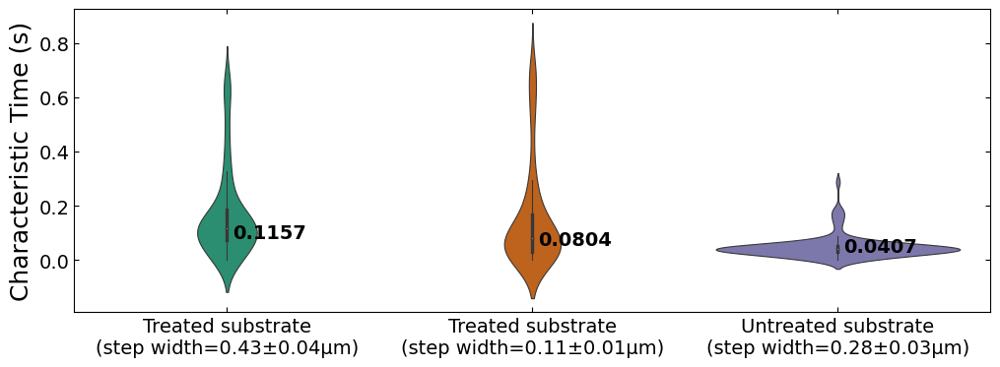

In [16]:
x_test6_sklearn, tau_test6_sklearn = np.swapaxes(np.load('../saved_data/test6_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test7_sklearn, tau_test7_sklearn = np.swapaxes(np.load('../saved_data/test7_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test9_sklearn, tau_test9_sklearn = np.swapaxes(np.load('../saved_data/test9_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]

x_test6_sklearn, tau_test6_sklearn = remove_outlier(x_test6_sklearn, tau_test6_sklearn, 0.9)
x_test7_sklearn, tau_test7_sklearn = remove_outlier(x_test7_sklearn, tau_test7_sklearn, 0.9)
x_test9_sklearn, tau_test9_sklearn = remove_outlier(x_test9_sklearn, tau_test9_sklearn, 0.9)

data = [tau_test6_sklearn, tau_test7_sklearn, tau_test9_sklearn]
fig, ax = plt.subplots(figsize=(12, 4))

titles = ['Treated substrate\n(step width=0.43±0.04μm)',
          'Treated substrate\n(step width=0.11±0.01μm)',
          'Untreated substrate\n(step width=0.28±0.03μm)']
ax = sns.violinplot(data=data, palette=[color_green, color_orange, color_purple], linewidth=0.8)
ax.set_xticklabels(titles)

label_violinplot(ax, data, label_type='average', text_pos='right')
ax.set_ylabel('Characteristic Time (s)')
plt.savefig('../figures/4.violinplot_plot(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()

### 4.3.2 Linear trend

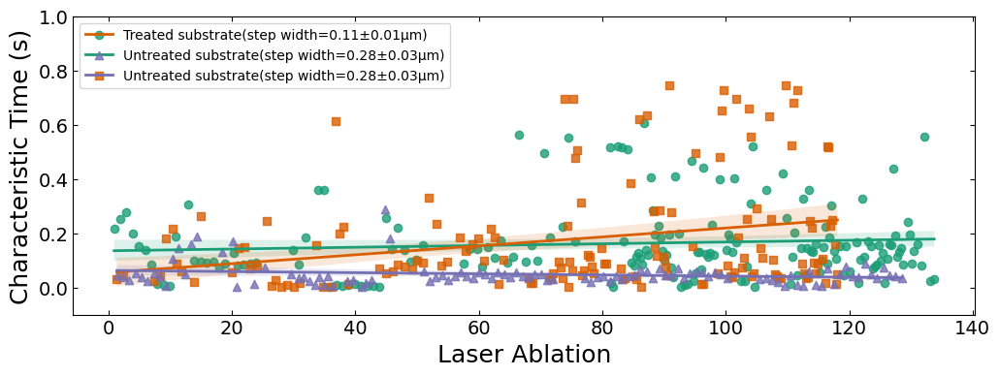

In [13]:
plt.rcParams.update(rc_plot)
titles = ['Treated substrate(step width=0.43±0.04μm)',
          'Treated substrate(step width=0.11±0.01μm)',
          'Untreated substrate(step width=0.28±0.03μm)']


fig, ax = plt.subplots(1, 1, figsize=(12, 4))
    
sns.regplot(ax=ax, x=x_test6_sklearn, y=tau_test6_sklearn, label=titles[0], 
            line_kws={'lw': 2, 'label': titles[0]},
            scatter=True, marker='o', color=color_green)
sns.regplot(ax=ax, x=x_test7_sklearn, y=tau_test7_sklearn, label=titles[1],
            line_kws={'lw': 2, 'label': titles[1]},
            scatter=True, marker='s', color=color_orange)
sns.regplot(ax=ax, x=x_test9_sklearn, y=tau_test9_sklearn, label=titles[2],
            line_kws={'lw': 2, 'label': titles[2]},
            scatter=True, marker='^', color=color_purple)
handles, labels = ax.get_legend_handles_labels()

n = 3
plt.legend(handles=[(h1, h2) for h1, h2 in zip(handles[:n], handles[n:])], labels=labels[n:], 
           fontsize=10)

plt.xlabel('Laser Ablation')
plt.ylabel('Characteristic Time (s)')
plt.ylim(-0.1, 1)
plt.savefig('../figures/4.linear_trend(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()